In [4]:
import numpy as np
import spateo as spt
import torch
import scanpy as sc
import scvelo as scv
import anndata as ad
import pandas as pd

/gpfs/share/home/2101110046/software/anaconda3/envs/spatial/lib/python3.8/site-packages/libpysal/cg/alpha_shapes.py:39: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/gpfs/share/home/2101110046/software/anaconda3/envs/spatial/lib/python3.8/site-packages/libpysal/cg/alpha_shapes.py:165: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/gpfs/share/home/2101110046/sof

In [5]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.pyplot import rc_context
from matplotlib.colors import Normalize, TwoSlopeNorm
from matplotlib.cm import ScalarMappable
import matplotlib.ticker as ticker

In [6]:
from data import load_data, data_pre_processing_ARTISTA_ae
from utils import seed_all
seed_all(123456789)

## load data

In [7]:
adata = spt.read_h5ad('./data/ARTISTA_after_pp.h5ad')

## load model

In [8]:
model_path = './model_result/model_ARTISTA_2.pth'
rigid_transformation_path = './model_result/rigid_ARTISTA_2.pth'

model = torch.load(model_path, map_location=torch.device('cpu'))
rigid_transformation = torch.load(rigid_transformation_path, map_location=torch.device('cpu'))

In [9]:
ae_model_path = './model_result/ARTISTA_ae_10.pth'
ae_model = torch.load(ae_model_path, map_location=torch.device('cpu'))

In [10]:
model_anno_path = './model_result/model_anno_ARTISTA_2.pth'
model_anno = torch.load(model_anno_path, map_location=torch.device('cpu'))

## load relevant function

In [11]:
# The function v_x, v_z and g of switching to gene expression
def raw_gene_space_velocity(ot_model_path, ae_model_path, device=torch.device('cpu')):
    ot_model = torch.load(ot_model_path, map_location=device)
    ae_model =  torch.load(ae_model_path, map_location=device)
    def velocity(cur_cell_gene, cur_cell_spatial, t):
        latent_embed = ae_model.encode_mlp1(cur_cell_gene)
        velocity_latent = ot_model.hyper_net1(torch.tensor(t, dtype=torch.float32), torch.cat((latent_embed, cur_cell_spatial), axis=1))
        velocity_raw = (ae_model.decode_mlp1(latent_embed + 0.1*velocity_latent) - ae_model.decode_mlp1(latent_embed - 0.1*velocity_latent))/0.2
        return velocity_raw, velocity_latent
    return velocity

def raw_spatital_velocity(ot_model_path, ae_model_path, device=torch.device('cpu')):
    ot_model = torch.load(ot_model_path, map_location=device)
    ae_model =  torch.load(ae_model_path, map_location=device)
    def velocity(cur_cell_gene, cur_cell_spatial, t):
        latent_embed = ae_model.encode_mlp1(cur_cell_gene)
        spatial_velocity = ot_model.hyper_net2(torch.tensor(t, dtype=torch.float32), torch.cat((latent_embed, cur_cell_spatial), axis=1))
        return spatial_velocity
    return velocity

def raw_gene_space_growth(ot_model_path, ae_model_path, device=torch.device('cpu')):
    ot_model = torch.load(ot_model_path, map_location=device)
    ae_model =  torch.load(ae_model_path, map_location=device)
    def growth(cur_cell_gene, cur_cell_spatial, t):
        latent_embed = ae_model.encode_mlp1(cur_cell_gene)
        cell_growth = ot_model.hyper_net3(torch.tensor(t, dtype=torch.float32), torch.cat((latent_embed, cur_cell_spatial), axis=1))
        return cell_growth
    return growth

In [12]:
# Time series classifier
def get_cell_type(cur_cell, model_anno, t):
    model_anno.eval()
    with torch.no_grad():
        time = torch.tensor(t.repeat(cur_cell.shape[0]), dtype=torch.float32).unsqueeze(1)
        inputs = torch.cat((cur_cell, time), dim=1)
        outputs = model_anno(inputs)
        cell_type_index = torch.argmax(torch.softmax(outputs, dim=1), dim=1)
        cur_cell_type = list(cell_type_unique[cell_type_index])
    return cur_cell_type

## data processing

In [13]:
data_pre_processing_ARTISTA_ae(adata, ae_model=ae_model)

1.0000000000000002
0.9999999999999999
0.9999999999999996
1.0
[[ 0.99703968 -0.07688869]
 [ 0.07688869  0.99703968]]
1.0000000000000002
1.0
1.0000000000000002
1.0000000000000002
[[ 0.99627382  0.08624658]
 [-0.08624658  0.99627382]]
1.0000000000000002
0.9999999999999999
1.0
0.9999999999999999
[[ 0.99934372 -0.03622337]
 [ 0.03622337  0.99934372]]
1.0000000000000002
1.0000000000000004
1.0000000000000007
0.9999999999999999
[[ 0.9734116  -0.22906299]
 [ 0.22906299  0.9734116 ]]
3420.923605242506


AnnData object with n_obs × n_vars = 46189 × 2000
    obs: 'CellID', 'spatial_leiden_e30_s8', 'Batch', 'cell_id', 'seurat_clusters', 'inj_uninj', 'D_V', 'Annotation', 'n_genes', 'time'
    var: 'Gene', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Annotation_colors', 'Injury_10DPI_rep1_SS200000147BL_B5', 'Injury_15DPI_rep4_FP200000266TR_E4', 'Injury_20DPI_rep2_SS200000147BL_B4', 'Injury_2DPI_rep1_SS200000147BL_D5', 'Injury_30DPI_rep2_FP200000264BL_A6', 'Injury_5DPI_rep1_SS200000147BL_D2', 'Injury_60DPI_rep3_FP200000264BL_A6', 'Injury_control_FP200000239BL_E3', 'angle_dict', 'hvg'
    obsm: 'X_pca', 'X_spatial', 'spatial', 'X_ae', 'X_input', 'spatial_input'
    layers: 'counts'

In [14]:
# Align data using the learned rigid body transformations
spatial_key = 'spatial_input'
integral_time = list(np.unique(adata.obs['time']))
time_pts = range(len(integral_time))
for i in time_pts:
    if i > 0:
        spatial_i = torch.tensor(adata[adata.obs.time == integral_time[i], :].obsm[spatial_key].copy(), dtype=torch.float32)
        spatial_i = rigid_transformation(spatial_i, i)
        adata.obsm[spatial_key][adata.obs.time == integral_time[i], :] = spatial_i.detach().numpy()

In [15]:
adata.obsm['X_spatial'] = adata.obsm[spatial_key]
adata.obsm['X_spatial_before_stVCR'] = adata.obsm['spatial'].copy()
adata.obsm['X_spatial_after_stVCR'] = adata.obsm['spatial_input'].copy()

In [16]:
data_train, train_time, integral_time = load_data(adata, device='cpu')
data_train_ori = data_train

In [17]:
# compute cell RNA velocity, spatial velocity and growth
velocity = raw_gene_space_velocity(model_path, ae_model_path, device=torch.device('cpu'))
spatial_velocity = raw_spatital_velocity(model_path, ae_model_path, device=torch.device('cpu'))
growth_gene = raw_gene_space_growth(model_path, ae_model_path, device=torch.device('cpu'))

velocity_T = np.zeros_like(adata.X.A)
velocity_ae = np.zeros_like(adata.obsm['X_ae'])
velocity_spatial = np.zeros_like(adata.obsm['X_spatial'])
cell_growth = np.zeros((adata.n_obs, 1))

for i in time_pts:
    cur_cell_gene = torch.tensor(adata[adata.obs.time==integral_time[i], :].X.A, requires_grad=False, dtype=torch.float32)
    cur_cell_spatial = torch.tensor(adata[adata.obs.time==integral_time[i], :].obsm['X_spatial'], requires_grad=False, dtype=torch.float32)

    cur_cell_velocity, cur_cell_velocity_ae = velocity(cur_cell_gene, cur_cell_spatial, integral_time[i])
    cur_cell_spatial_velocity = spatial_velocity(cur_cell_gene, cur_cell_spatial, integral_time[i])
    cur_cell_growth = growth_gene(cur_cell_gene, cur_cell_spatial, integral_time[i])

    velocity_T[adata.obs.time==integral_time[i], :] = cur_cell_velocity.detach().numpy()
    velocity_ae[adata.obs.time==integral_time[i], :] = cur_cell_velocity_ae.detach().numpy()
    velocity_spatial[adata.obs.time==integral_time[i], :] = cur_cell_spatial_velocity.detach().numpy()
    cell_growth[adata.obs.time==integral_time[i]] = cur_cell_growth.detach().numpy()

In [18]:
adata.layers['M_T'] = adata.X.A
adata.layers['velocity_T'] = velocity_T
adata.obsm['velocity_ae'] = velocity_ae
adata.obsm['velocity_spatial'] = velocity_spatial
adata.obs['cell_growth'] = cell_growth.squeeze()

In [19]:
# Delete the extra part of the gene name
var_names = adata.var_names
var_names_new = [s.split("|")[0].strip() for s in list(var_names)]

In [20]:
adata.var_names = var_names_new
adata.var['var_names_new'] = var_names_new

In [21]:
# set cell type color map
cell_type_Annotation = adata.obs['Annotation'].cat.categories.values
cell_type_color_map = dict(zip(cell_type_Annotation, adata.uns['Annotation_colors']))
cell_type_unique = np.unique(adata.obs['Annotation'])

In [22]:
adata

AnnData object with n_obs × n_vars = 46189 × 2000
    obs: 'CellID', 'spatial_leiden_e30_s8', 'Batch', 'cell_id', 'seurat_clusters', 'inj_uninj', 'D_V', 'Annotation', 'n_genes', 'time', 'cell_growth'
    var: 'Gene', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'var_names_new'
    uns: 'Annotation_colors', 'Injury_10DPI_rep1_SS200000147BL_B5', 'Injury_15DPI_rep4_FP200000266TR_E4', 'Injury_20DPI_rep2_SS200000147BL_B4', 'Injury_2DPI_rep1_SS200000147BL_D5', 'Injury_30DPI_rep2_FP200000264BL_A6', 'Injury_5DPI_rep1_SS200000147BL_D2', 'Injury_60DPI_rep3_FP200000264BL_A6', 'Injury_control_FP200000239BL_E3', 'angle_dict', 'hvg'
    obsm: 'X_pca', 'X_spatial', 'spatial', 'X_ae', 'X_input', 'spatial_input', 'X_spatial_before_stVCR', 'X_spatial_after_stVCR', 'velocity_ae', 'velocity_spatial'
    layers: 'counts', 'M_T', 'velocity_T'

In [23]:
adata.obs['time_batch'] = ['']*adata.n_obs
adata.obs['time_batch'][adata.obs.time==integral_time[0]] = '2DPI'
adata.obs['time_batch'][adata.obs.time==integral_time[1]] = '5DPI'
adata.obs['time_batch'][adata.obs.time==integral_time[2]] = '10DPI'
adata.obs['time_batch'][adata.obs.time==integral_time[3]] = '15DPI'
adata.obs['time_batch'][adata.obs.time==integral_time[4]] = '20DPI'
adata.uns['time_batch_colors'] = ['#E74C3C', '#3498DB', '#F1C40F', '#2ECC71', '#9B59B6']
# adata.obs.time_batch

In [24]:
# Split the data into different time points
adata_2DPI = adata[adata.obs.time==integral_time[0], :]
adata_5DPI = adata[adata.obs.time==integral_time[1], :]
adata_10DPI = adata[adata.obs.time==integral_time[2], :]
adata_15DPI = adata[adata.obs.time==integral_time[3], :]
adata_20DPI = adata[adata.obs.time==integral_time[4], :]

In [25]:
# set save path
save_path = './ARTISTA_figure/'

## Plot the aligned data

In [26]:
# Set parameters
sc.set_figure_params(dpi=150, dpi_save=400, frameon=False, fontsize=8, transparent=True)
sc.settings.verbosity = 0
sc.logging.print_header()

scanpy==1.9.8 anndata==0.9.2 umap==0.5.5 numpy==1.24.3 scipy==1.10.1 pandas==1.3.5 scikit-learn==1.3.0 statsmodels==0.14.1 igraph==0.10.8 louvain==0.8.0 pynndescent==0.5.11


In [27]:
# Load the relevant plot function
def plot_after_alignment_scanpy(adata, title, figsize, color_key='Annotation', spatial_key='spatial_after_stVCR', pointsize=1, save_path=None, show_legend=False):
    if show_legend:
        legend_loc = 'right margin'
    else:
        legend_loc = 'none'
    # rc_context is used for the figure size
    with rc_context({"figure.figsize": figsize}):
        fig, ax = plt.subplots()
        sc.pl.scatter(adata, basis=spatial_key, color=color_key,
                      size = pointsize, legend_loc=legend_loc, show=False,ax=ax)
        if title is False:
            plt.title('')
        elif title is not None:
            plt.title(title)
        if save_path:
            plt.savefig(save_path, bbox_inches='tight')

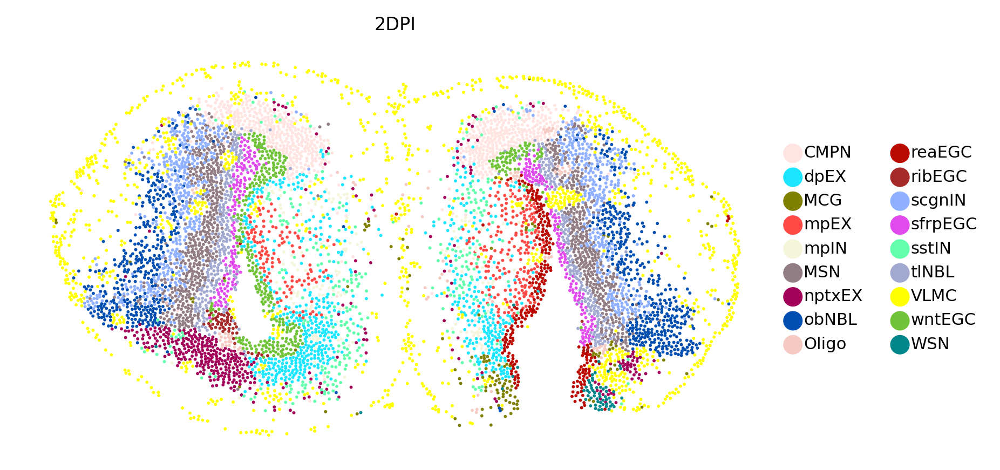

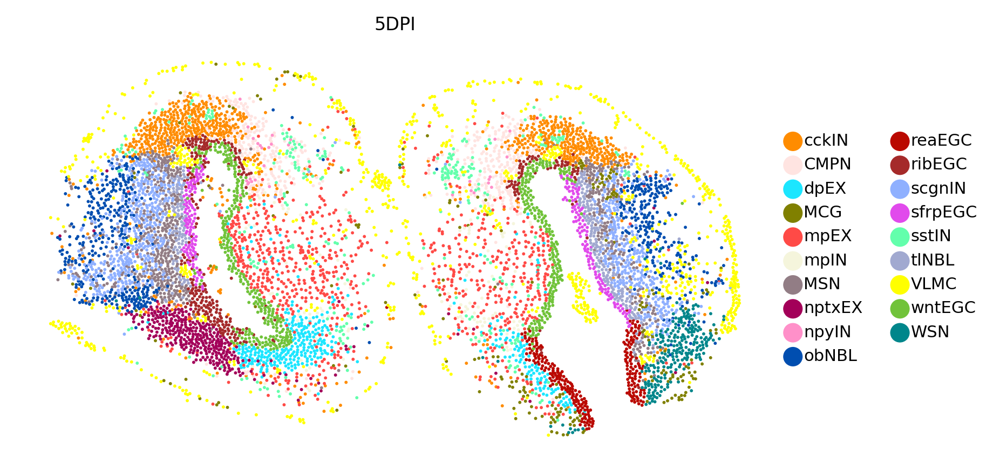

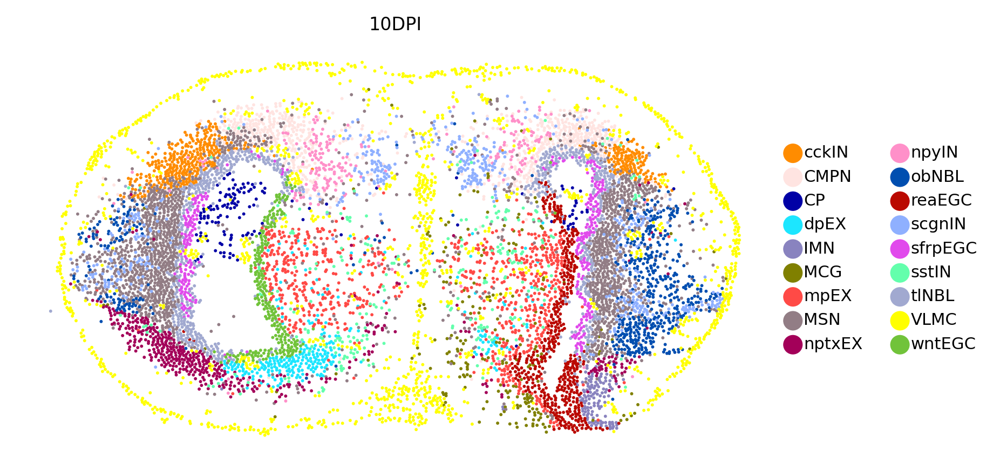

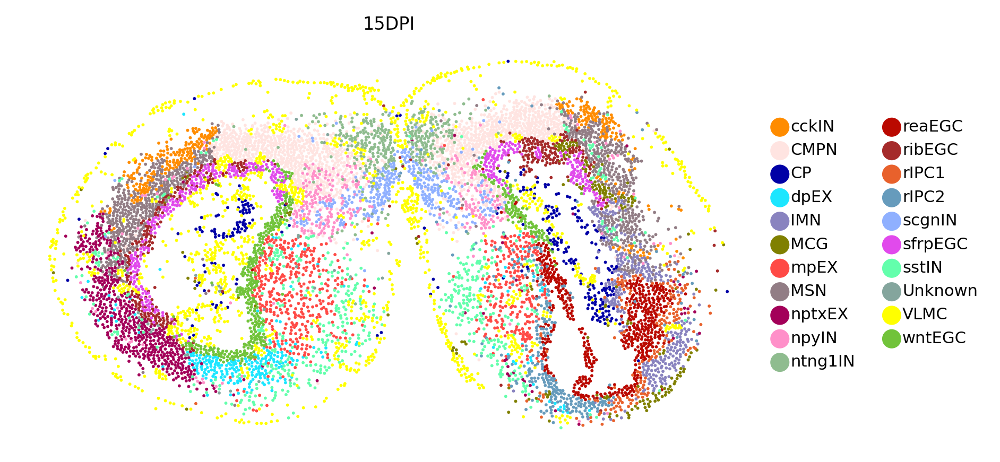

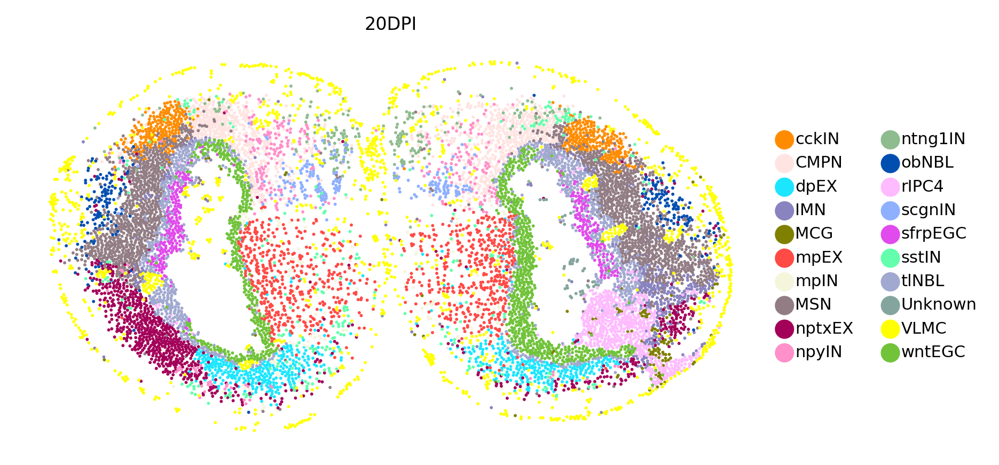

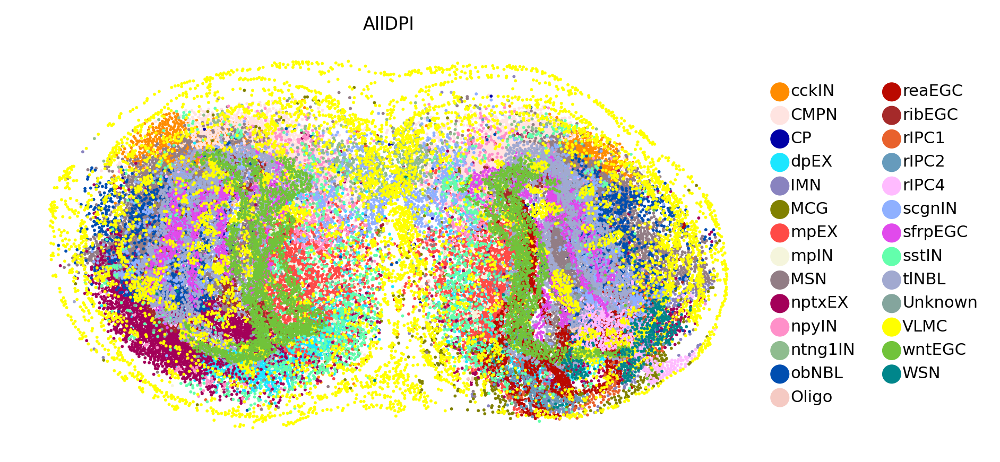

In [28]:
plot_after_alignment_scanpy(adata_2DPI, figsize=(6, (5*2/3)), pointsize=8, title='2DPI', show_legend=True)
plot_after_alignment_scanpy(adata_5DPI, figsize=(6, (5*2/3)), pointsize=8, title='5DPI', show_legend=True)
plot_after_alignment_scanpy(adata_10DPI, figsize=(6, (5*2/3)), pointsize=8, title='10DPI', show_legend=True)
plot_after_alignment_scanpy(adata_15DPI, figsize=(6, (5*2/3)), pointsize=8, title='15DPI', show_legend=True)
plot_after_alignment_scanpy(adata_20DPI, figsize=(6, (5*2/3)), pointsize=8, title='20DPI', show_legend=True)
plot_after_alignment_scanpy(adata, figsize=(6, (5*2/3)), pointsize=8, title='AllDPI', show_legend=True)

In [29]:
# load the relevant plot function
def plot_before_and_after_alignment_scanpy(adata, title, figsize, pointsize=1, save_path=None, show_legend=False):
    from pandas.api.types import CategoricalDtype
    if show_legend:
        legend_loc = 'right margin'
    else:
        legend_loc = 'none'

    counts_temp = np.zeros((adata.n_obs, 2))

    adata_before = ad.AnnData(counts_temp)
    adata_before.obs['stVCR'] = 'Before stVCR'
    adata_before.obsm['X_spatial_plot'] = adata.obsm['X_spatial_before_stVCR'].copy()
    adata_before.obs.index = adata_before.obs.index+'before'
    
    adata_after = ad.AnnData(counts_temp)
    adata_after.obs['stVCR'] = 'After stVCR'
    adata_after.obsm['X_spatial_plot'] = adata.obsm['X_spatial_after_stVCR'].copy()
    adata_after.obs.index = adata_after.obs.index+'after'
    
    
    adata_temp = sc.AnnData.concatenate(adata_before,adata_after)
    grade_dtype = CategoricalDtype(categories=['Before stVCR', 'After stVCR'], ordered=True)
    adata_temp.obs['stVCR'] = pd.Series(adata_temp.obs.stVCR).astype(grade_dtype)
    # adata_temp.uns['stVCR_colors'] = ['#FF7F50', '#6A5ACD']
    
    # rc_context is used for the figure size
    with rc_context({"figure.figsize": figsize}):
        fig, ax = plt.subplots()
        sc.pl.scatter(adata_temp, basis='spatial_plot', color='stVCR',
                      size = pointsize, legend_loc=legend_loc, show=False,ax=ax)
        if title is False:
            plt.title('')
        elif title is not None:
            plt.title(title)
        if save_path:
            plt.savefig(save_path, bbox_inches='tight')

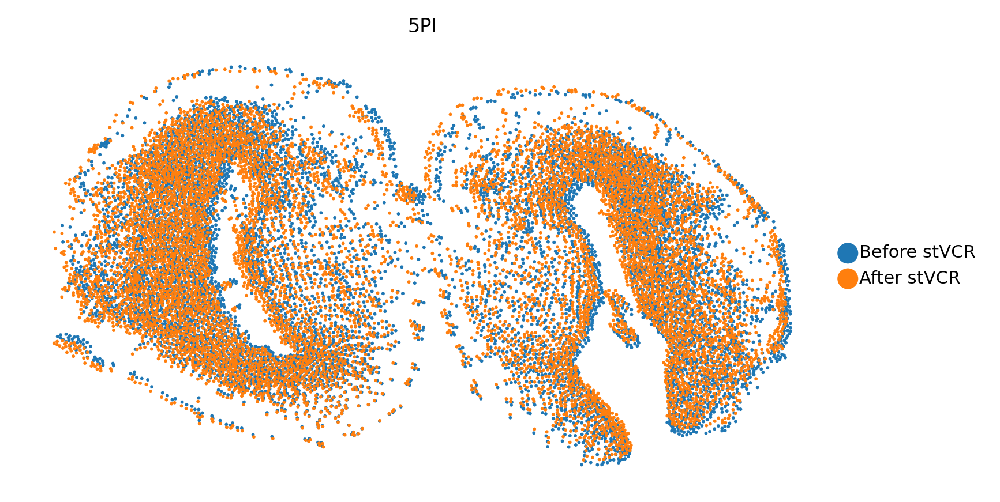

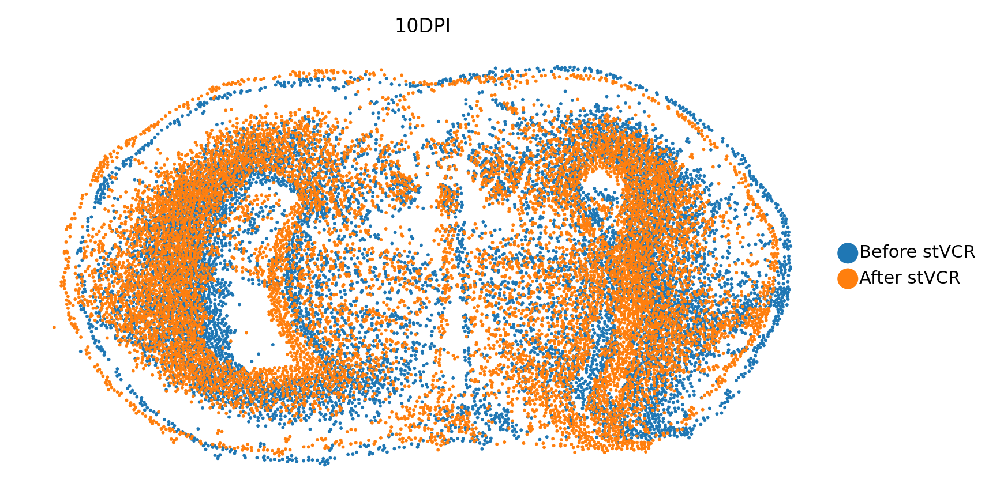

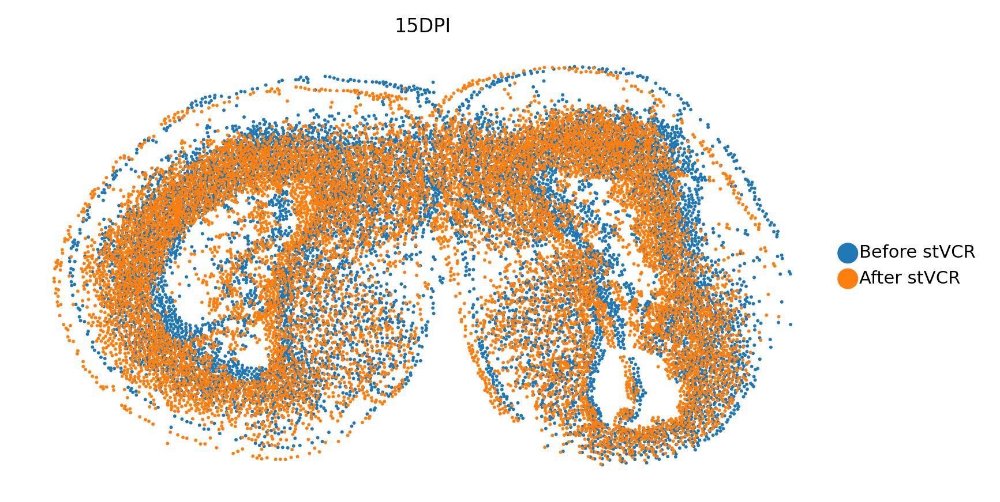

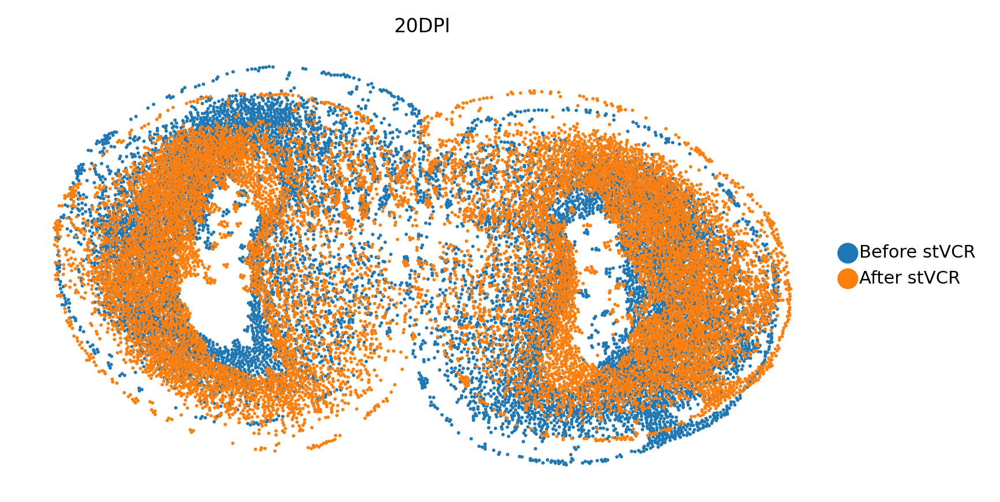

In [30]:
plot_before_and_after_alignment_scanpy(adata_5DPI,  figsize=(6, (5*2/3)), pointsize=8, title='5PI', show_legend=True)
plot_before_and_after_alignment_scanpy(adata_10DPI,  figsize=(6, (5*2/3)), pointsize=8, title='10DPI', show_legend=True)
plot_before_and_after_alignment_scanpy(adata_15DPI,  figsize=(6, (5*2/3)), pointsize=8, title='15DPI', show_legend=True)
plot_before_and_after_alignment_scanpy(adata_20DPI,  figsize=(6, (5*2/3)), pointsize=8, title='20DPI', show_legend=True)

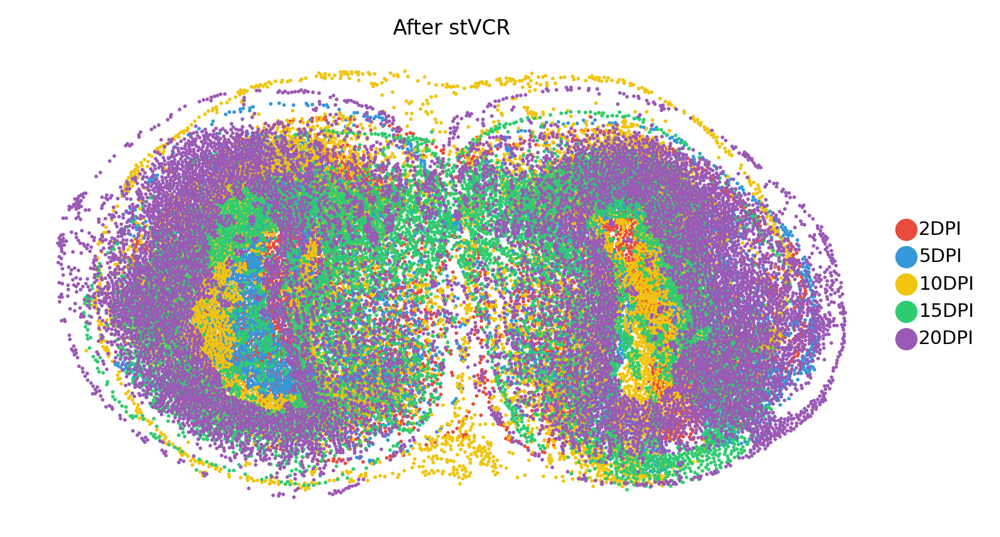

In [31]:
plot_after_alignment_scanpy(adata, figsize=(6, (5*2/3)), spatial_key='spatial_after_stVCR', color_key='time_batch', pointsize=8, title='After stVCR', show_legend=True)

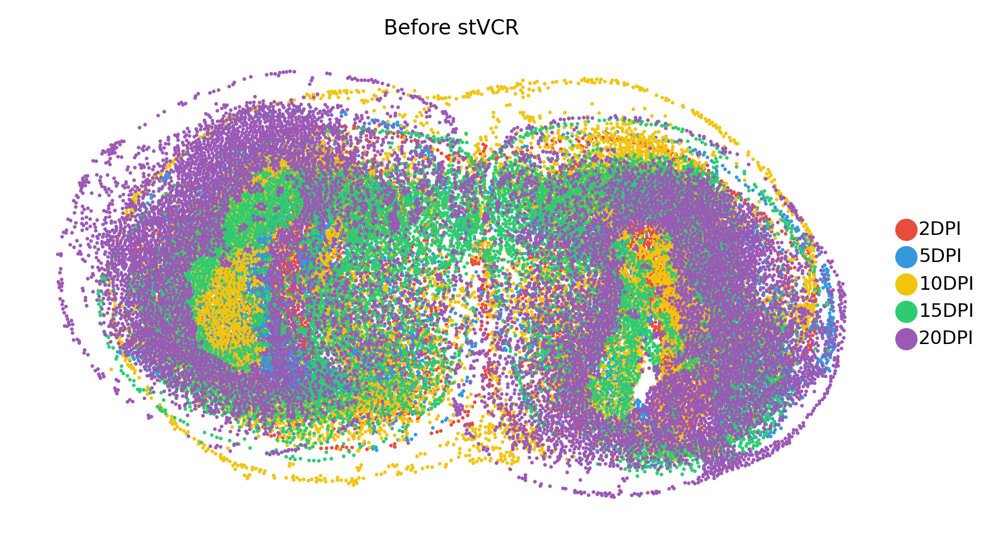

In [32]:
plot_after_alignment_scanpy(adata, figsize=(6, (5*2/3)), spatial_key='spatial_before_stVCR', color_key='time_batch', pointsize=8, title='Before stVCR', show_legend=True)

## Plot spatial velocity in injured hemisphere

In [33]:
# load the relevant plot function
def plot_velocity_scanpy(adata, title, figsize, arrow_length=6, linewidth=0.5, arrow_size=1, grid_or_stream='stream', pointsize=50, save_path=None, show_legend=False):
    if show_legend:
        legend_loc = 'right margin'
    else:
        legend_loc = 'none'
    # rc_context is used for the figure size
    with rc_context({"figure.figsize": figsize}):
        if grid_or_stream == 'stream':
            scv.pl.velocity_embedding_stream(adata, color='Annotation', basis='spatial', linewidth=linewidth, arrow_size=arrow_size,
                                             size = pointsize, legend_loc=legend_loc, show=False)
        elif grid_or_stream == 'grid':
            scv.pl.velocity_embedding_grid(adata, color='Annotation', basis='spatial', arrow_length=arrow_length, arrow_size=arrow_size,
                                           size = pointsize, legend_loc=legend_loc, show=False)
        plt.grid(False)
        if title is False:
            plt.title('')
        elif title is not None:
            plt.title(title)
            
        if save_path:
            plt.savefig(save_path, bbox_inches='tight')

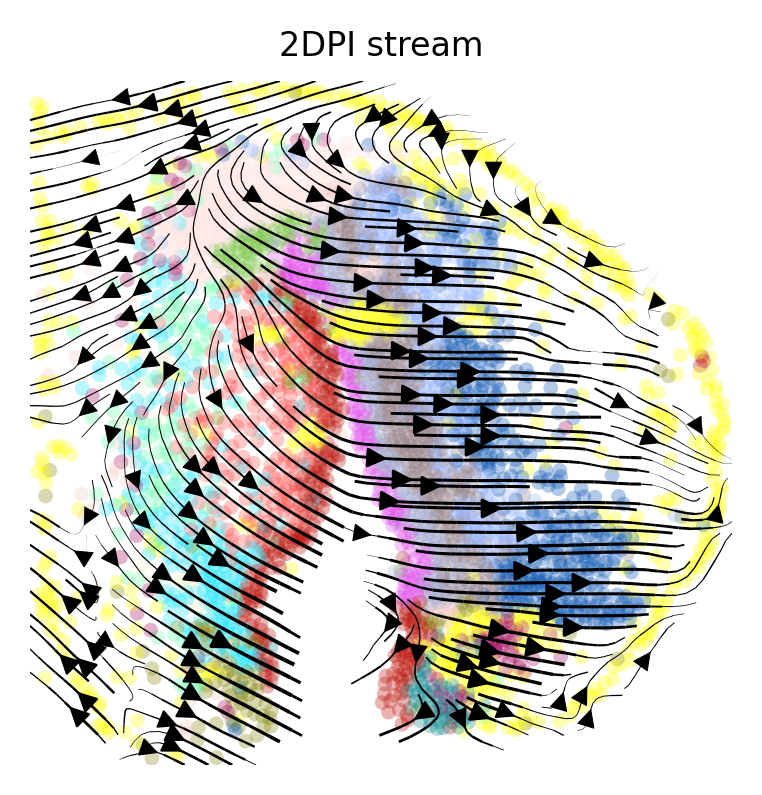

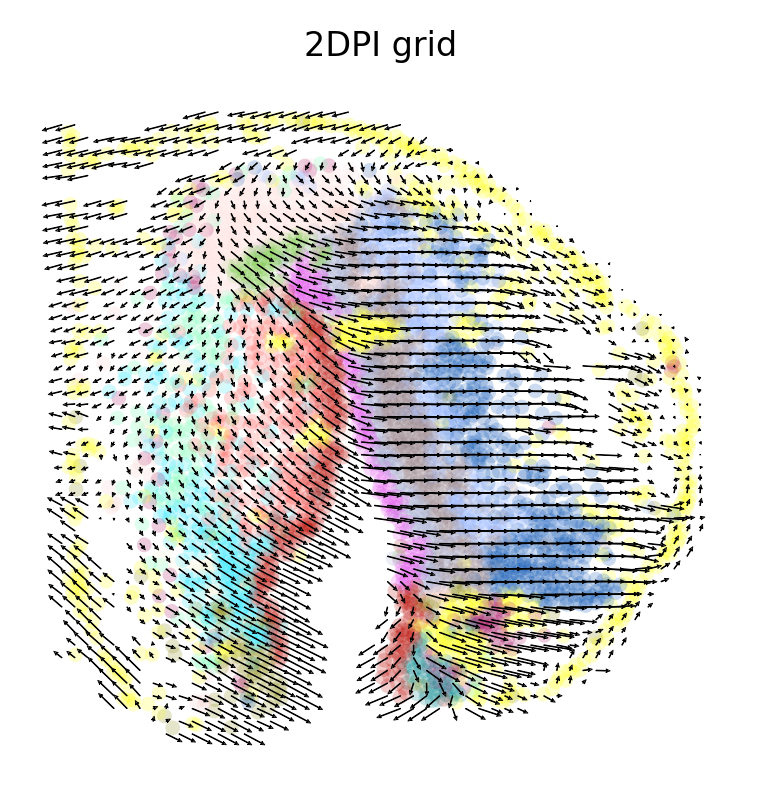

In [34]:
## 2DPI
inj_2DPI = adata_2DPI[adata_2DPI.obs['inj_uninj'] == 'inj', :]
plot_velocity_scanpy(inj_2DPI, title='2DPI stream', figsize=(3,3), grid_or_stream='stream')
plot_velocity_scanpy(inj_2DPI, title='2DPI grid', figsize=(3,3), grid_or_stream='grid')

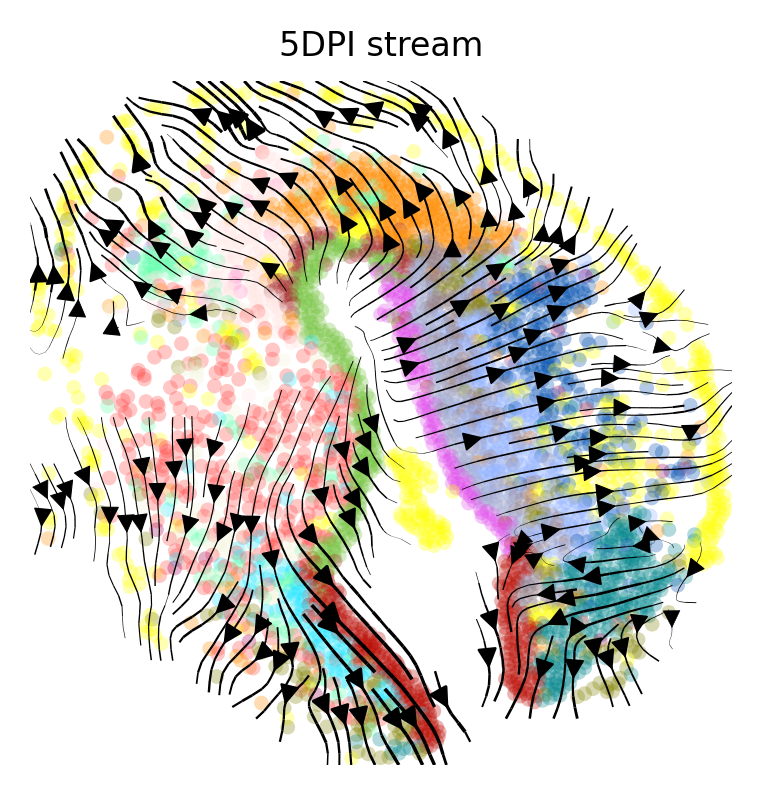

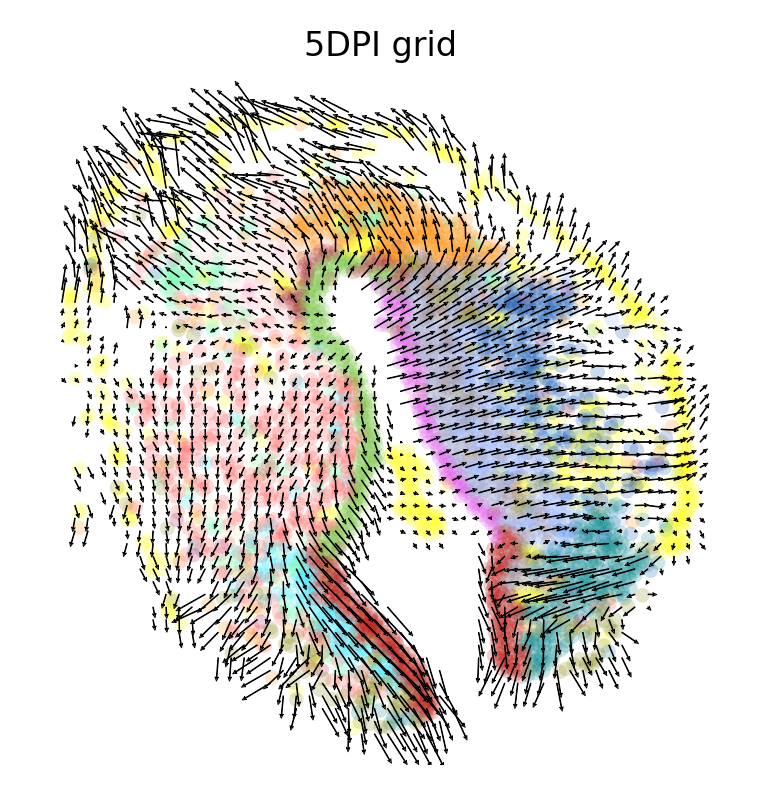

In [35]:
# 5DPI
inj_5DPI = adata_5DPI[adata_5DPI.obs['inj_uninj'] == 'inj', :]
plot_velocity_scanpy(inj_5DPI, title='5DPI stream', figsize=(3,3), grid_or_stream='stream')
plot_velocity_scanpy(inj_5DPI, title='5DPI grid', figsize=(3,3), grid_or_stream='grid')

## Plot cell growth rate

In [36]:
# load the relevant plot function
def plot_obs_key(adata, title, figsize, spatial_key='X_spatial_after_stVCR', color_key='cell_growth', cmap='coolwarm', pointsize=0.2, save_path=None):

    color_value = adata.obs[color_key]
    cur_max = np.maximum(np.abs(color_value.max()), np.abs(color_value.min()))
    # cur_max = 0.03
    norm = TwoSlopeNorm(vcenter=0, vmin=-cur_max, vmax=cur_max)
    mapper = ScalarMappable(norm=norm, cmap='coolwarm')
    
    # rc_context is used for the figure size
    with rc_context({"figure.figsize": figsize}):
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.clear()
        ax.set_xlim(-1.01, 1.01)
        ax.set_ylim(-1.01, 1.01)
        
        ax.scatter(adata.obsm[spatial_key][:, -2], adata.obsm[spatial_key][:, -1],
                    c=color_value, cmap=cmap, alpha=1, norm=norm, s=pointsize, marker='o',edgecolors='none')
        ax.axis('off')
        
        plt.xticks([])
        plt.yticks([])

        # plt.xlabel('X')
        # plt.ylabel('Y')
        
        cbar = plt.colorbar(mapper)
        cbar.formatter = ticker.ScalarFormatter()
        cbar.formatter.set_scientific(True)
        cbar.formatter.set_powerlimits((0, 0))
        cbar.update_ticks()
        
        if title is False:
            plt.title('')
        elif title is not None:
            plt.title(title)
        if save_path:
            plt.savefig(save_path, bbox_inches='tight')

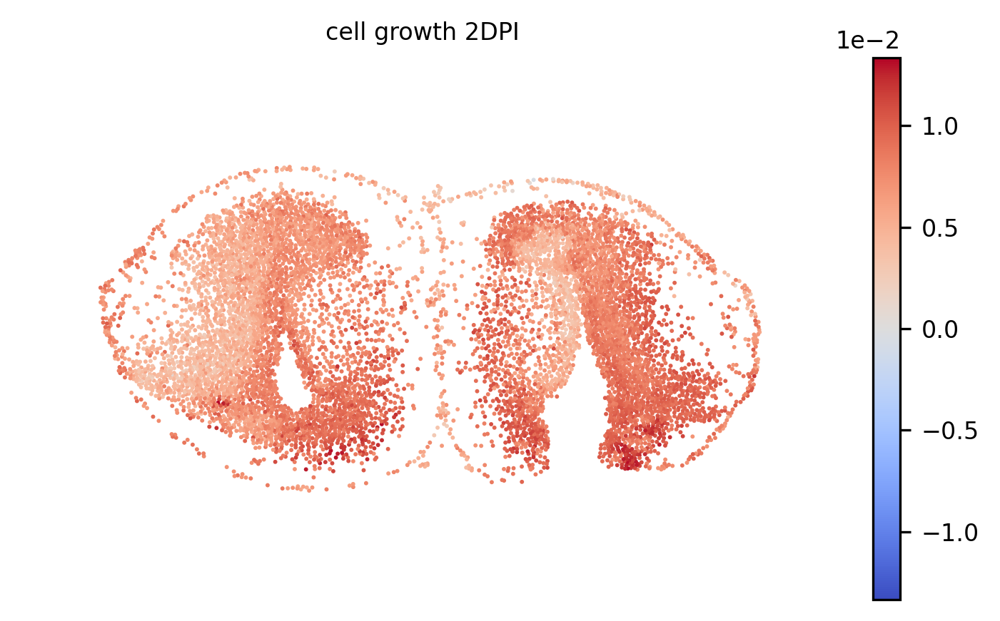

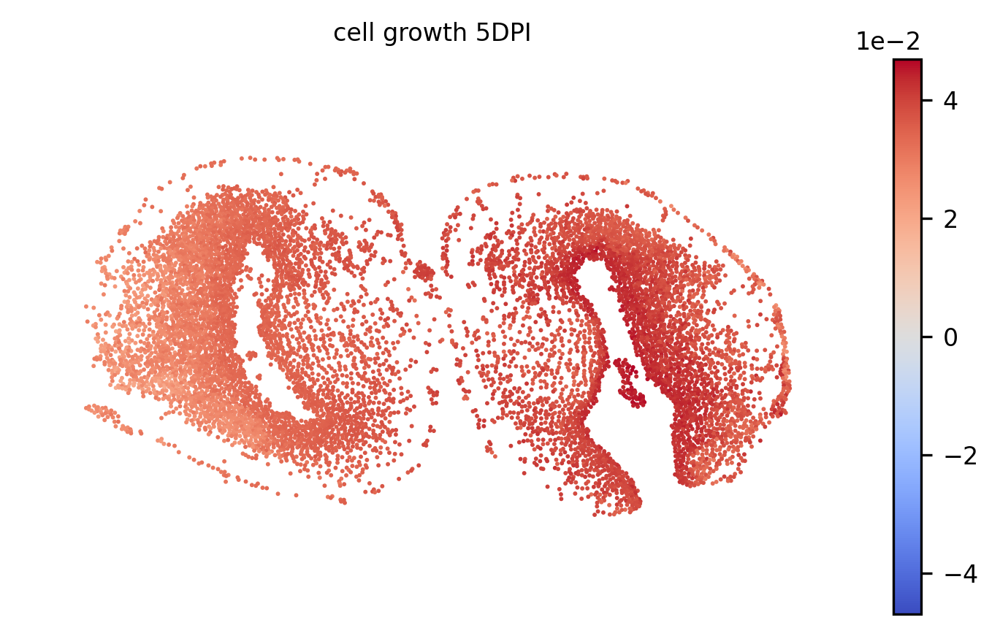

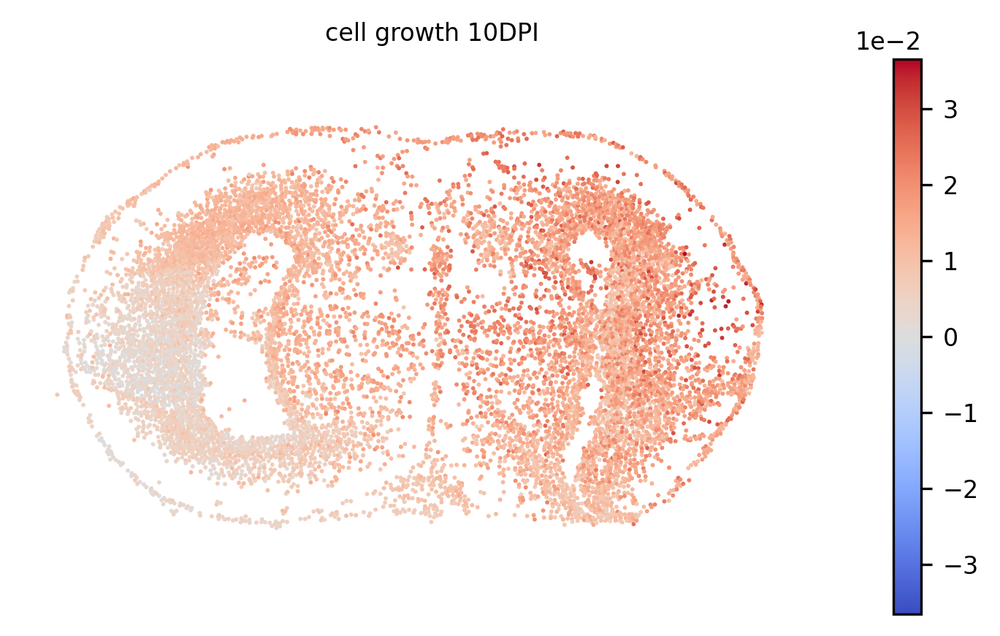

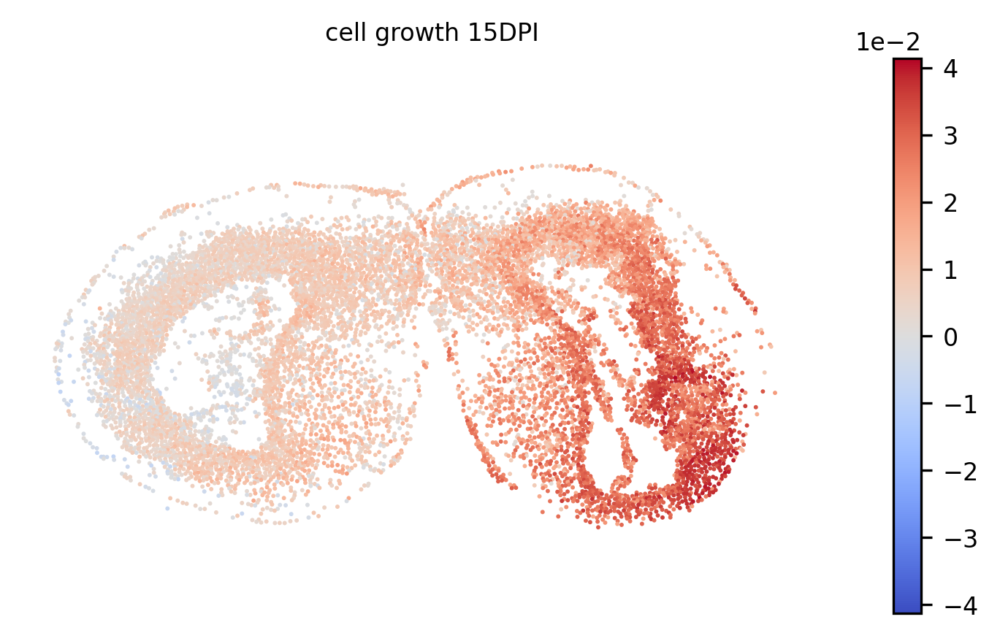

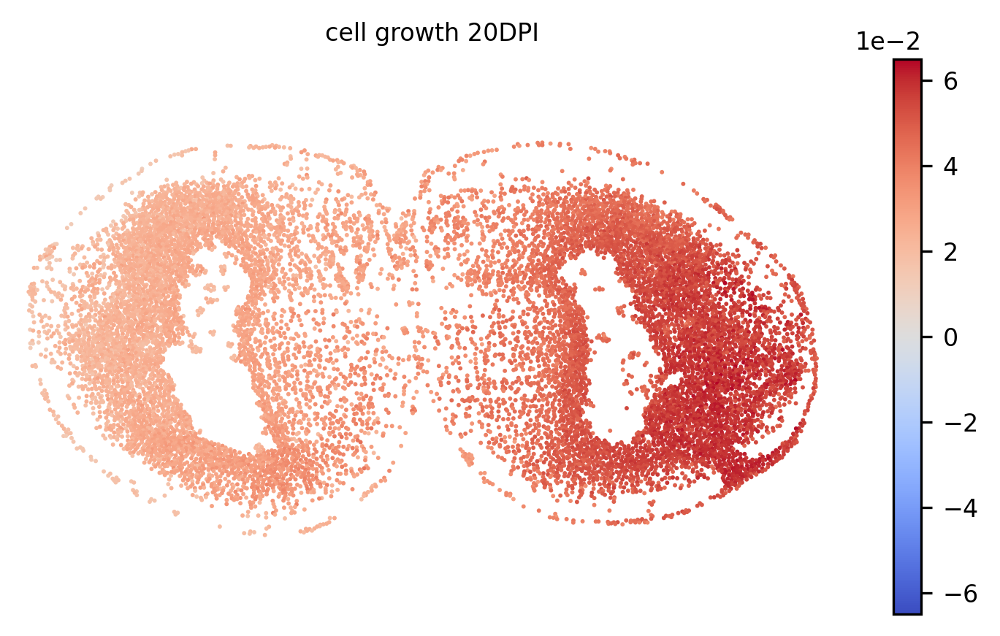

In [37]:
plot_obs_key(adata_2DPI, title='cell growth 2DPI', figsize=(6, (5*2/3)), color_key='cell_growth', cmap='coolwarm',pointsize=2)
plot_obs_key(adata_5DPI, title='cell growth 5DPI', figsize=(6, (5*2/3)), color_key='cell_growth', cmap='coolwarm',pointsize=2)
plot_obs_key(adata_10DPI, title='cell growth 10DPI', figsize=(6, (5*2/3)), color_key='cell_growth', cmap='coolwarm',pointsize=2)
plot_obs_key(adata_15DPI, title='cell growth 15DPI', figsize=(6, (5*2/3)), color_key='cell_growth', cmap='coolwarm',pointsize=2)
plot_obs_key(adata_20DPI, title='cell growth 20DPI', figsize=(6, (5*2/3)), color_key='cell_growth', cmap='coolwarm',pointsize=2)

## Plot interpolation result

In [38]:
common_initial_time_point = 2.0

In [39]:
def evolution_forward(init_cell, model, model_anno, init_time, end_time, init_cell_type=None, delta_t = 0.1):
    def growth(x, delta_t, model, t, cur_cell_id, sigma_d=0.00001):
        cell_number = x.shape[0]
        x_growth = []
        new_cell_id = []
        g = model.hyper_net3(torch.tensor(t, dtype=torch.float32), x)
        for i in range(cell_number):
            g_i = g[i, :]
            temp = np.random.rand()
            if g_i > 0 and temp < (g_i * delta_t):
                x_growth.append(x[i, :])
                new_cell_id.append(cur_cell_id[i])
                
                new_cell = x[i, :] + sigma_d * torch.tensor(np.random.randn(x[i, :].shape[0]))
                # new_cell[0:3] = torch.maximum(new_cell[0:3], torch.tensor(0.0))
                x_growth.append(new_cell)
                new_cell_id.append(cur_cell_id[i])
            elif g_i > 0 and temp > (g_i * delta_t):
                x_growth.append(x[i, :])
                new_cell_id.append(cur_cell_id[i])
            elif g_i < 0 and temp > (-g_i * delta_t):
                x_growth.append(x[i, :])
                new_cell_id.append(cur_cell_id[i])
        cur_cell = torch.vstack(x_growth)
        cur_cell = torch.tensor(cur_cell, dtype=torch.float32)
        return cur_cell, new_cell_id
    
    time_point = np.arange(init_time, end_time, delta_t)
    time_point = np.union1d(time_point, end_time)
    time_point = np.round(time_point, 1)
    time_step = time_point[1:] - time_point[0:-1]
    
    all_time_point = list(time_point)
    all_exp = []
    all_spa = []
    all_cell_type = []
    all_cell_id = []
    
    cur_cell = init_cell
    cur_cell_id = np.arange(cur_cell.shape[0])
    if init_cell_type is None:
        cur_cell_type = get_cell_type(cur_cell, model_anno, time_point[0])
    else:
        cur_cell_type = [init_cell_type]*cur_cell.shape[0]
    
    for i in range(len(time_point)):
        all_exp.append(cur_cell[:, 0:-2].detach().numpy())
        all_spa.append(cur_cell[:, -2:].detach().numpy())
        all_cell_id.append(cur_cell_id)

        if i > 0:
            cur_cell_type = get_cell_type(cur_cell, model_anno, time_point[i])
    
        all_cell_type.append(cur_cell_type)
    
        if i < len(time_step):
            cur_cell, cur_cell_id = growth(cur_cell, time_step[i], model, time_point[i], cur_cell_id)
            cur_cell[:, 0:-2] = cur_cell[:, 0:-2] + time_step[i] * model.hyper_net1(
                torch.tensor(time_point[i], dtype=torch.float32), cur_cell)
            cur_cell[:, -2:] = cur_cell[:, -2:] + time_step[i] * model.hyper_net2(
                torch.tensor(time_point[i], dtype=torch.float32), cur_cell)
    return all_exp, all_spa, all_cell_type, all_cell_id, all_time_point

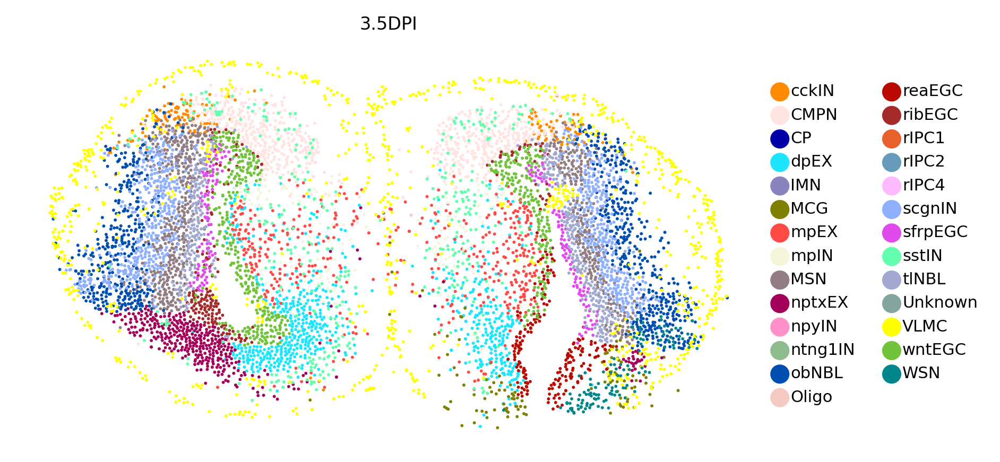

In [40]:
# from 2DPI to 3.5DPI
init_cell_2DPI = data_train[train_time[0]]
init_time = 2 - common_initial_time_point
end_time = 3.5 - common_initial_time_point
_, all_spa, all_cell_type, _, _ = evolution_forward(init_cell_2DPI, model, model_anno, init_time, end_time, delta_t = 0.1)

adata_3dot5DPI = ad.AnnData(np.zeros((len(all_cell_type[-1]),2)))
adata_3dot5DPI.obsm['X_spatial_after_stVCR'] = all_spa[-1]
categories = adata.obs['Annotation'].cat.categories
adata_3dot5DPI.obs['Annotation'] = pd.Series(pd.Categorical(all_cell_type[-1], categories=categories), index=adata_3dot5DPI.obs.index)
adata_3dot5DPI.uns['Annotation_colors'] = adata.uns['Annotation_colors']

plot_after_alignment_scanpy(adata_3dot5DPI, figsize=(6, (5*2/3)), pointsize=8, title='3.5DPI', show_legend=True)

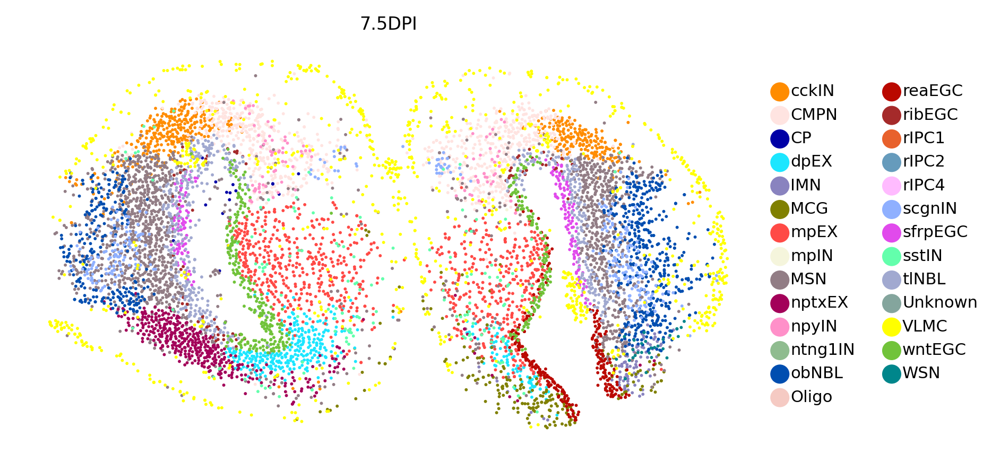

In [41]:
# from 5DPI to 7.5DPI
init_cell_5DPI = data_train[train_time[1]]
init_time = 5 - common_initial_time_point
end_time = 7.5 - common_initial_time_point
_, all_spa, all_cell_type, _, _ = evolution_forward(init_cell_5DPI, model, model_anno, init_time, end_time, delta_t = 0.1)

adata_7dot5DPI = ad.AnnData(np.zeros((len(all_cell_type[-1]),2)))
adata_7dot5DPI.obsm['X_spatial_after_stVCR'] = all_spa[-1]
categories = adata.obs['Annotation'].cat.categories
adata_7dot5DPI.obs['Annotation'] = pd.Series(pd.Categorical(all_cell_type[-1], categories=categories), index=adata_7dot5DPI.obs.index)
adata_7dot5DPI.uns['Annotation_colors'] = adata.uns['Annotation_colors']

plot_after_alignment_scanpy(adata_7dot5DPI, figsize=(6, (5*2/3)), pointsize=8, title='7.5DPI', show_legend=True)

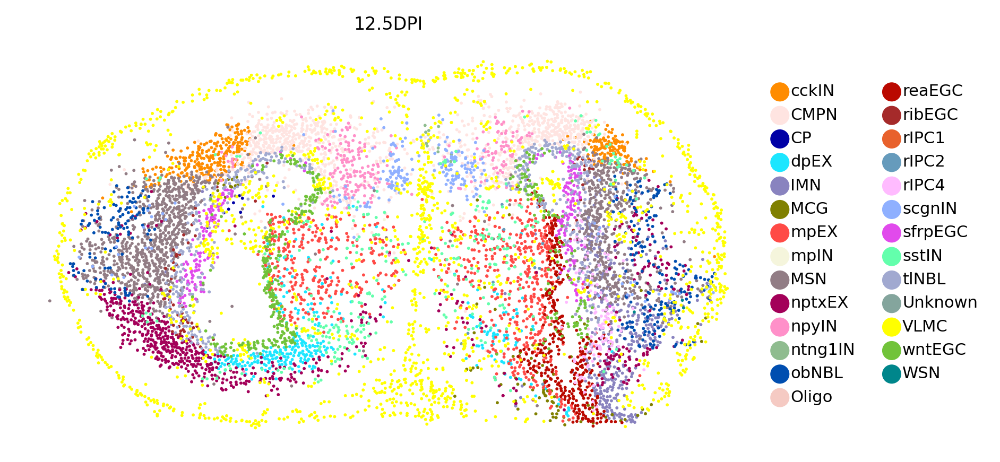

In [42]:
# from 10DPI to 12.5DPI
init_cell_10DPI = data_train[train_time[2]]
init_time = 10 - common_initial_time_point
end_time = 12.5 - common_initial_time_point
_, all_spa, all_cell_type, _, _ = evolution_forward(init_cell_10DPI, model, model_anno, init_time, end_time, delta_t = 0.1)

adata_12dot5DPI = ad.AnnData(np.zeros((len(all_cell_type[-1]),2)))
adata_12dot5DPI.obsm['X_spatial_after_stVCR'] = all_spa[-1]
categories = adata.obs['Annotation'].cat.categories
adata_12dot5DPI.obs['Annotation'] = pd.Series(pd.Categorical(all_cell_type[-1], categories=categories), index=adata_12dot5DPI.obs.index)
adata_12dot5DPI.uns['Annotation_colors'] = adata.uns['Annotation_colors']

plot_after_alignment_scanpy(adata_12dot5DPI, figsize=(6, (5*2/3)), pointsize=8, title='12.5DPI', show_legend=True)

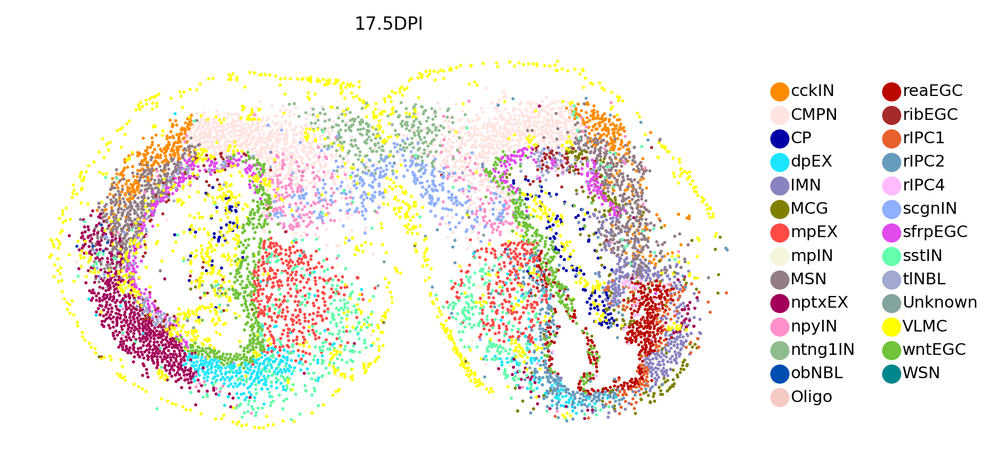

In [43]:
# from 15DPI to 17.5DPI
init_cell_15DPI = data_train[train_time[3]]
init_time = 15 - common_initial_time_point
end_time = 17.5 - common_initial_time_point
_, all_spa, all_cell_type, _, _ = evolution_forward(init_cell_15DPI, model, model_anno, init_time, end_time, delta_t = 0.1)

adata_17dot5DPI = ad.AnnData(np.zeros((len(all_cell_type[-1]),2)))
adata_17dot5DPI.obsm['X_spatial_after_stVCR'] = all_spa[-1]
categories = adata.obs['Annotation'].cat.categories
adata_17dot5DPI.obs['Annotation'] = pd.Series(pd.Categorical(all_cell_type[-1], categories=categories), index=adata_17dot5DPI.obs.index)
adata_17dot5DPI.uns['Annotation_colors'] = adata.uns['Annotation_colors']

plot_after_alignment_scanpy(adata_17dot5DPI, figsize=(6, (5*2/3)), pointsize=8, title='17.5DPI', show_legend=True)

## Construct time series developmental lineages

In [44]:
class CellNode:
    def __init__(self, cell_type):
        self.cell_type = cell_type
        self.children = {}
        self.count = 0

def build_transition_tree(all_cell_id, all_cell_type, all_time_point, time_points):
    positions = [all_time_point.index(cur_time_point) for cur_time_point in time_points]
    time_points_data = [(all_cell_type[index], all_cell_id[index]) for index in positions]
    
    if not time_points_data:
        return None
    
    # Initialize the root node with the first time point's unique cell type
    root_type = time_points_data[0][0][0]
    root = CellNode(root_type)
    root.count = len(time_points_data[0][1])
    
    # Dictionary to keep track of current nodes by their ID
    current_nodes = {i: root for i in time_points_data[0][1]}
    
    # Process each time point starting from the second one
    for types, ids in time_points_data[1:]:
        next_nodes = {}
        for cell_type, cell_id in zip(types, ids):
            if cell_id in current_nodes:
                parent_node = current_nodes[cell_id]
                if cell_type not in parent_node.children:
                    parent_node.children[cell_type] = CellNode(cell_type)
                child_node = parent_node.children[cell_type]
                child_node.count += 1
                next_nodes[cell_id] = child_node
        
        # Update current_nodes for the next iteration
        current_nodes = next_nodes
    
    return root

def print_tree(node, level=0, threshold=20):
    if node.count > threshold:
        print("  " * level + f"{node.cell_type} ({node.count})")
        for child in node.children.values():
            print_tree(child, level + 1, threshold)

def plot_sankey_from_tree(transition_tree, cell_type_color_map, threshold=20, title=None, font_size=7, width = 725, height=400, scale=5, save_path=None):
    def tree_to_sankey(transition_tree, threshold, cell_type_color_map):
        labels = []
        sources = []
        targets = []
        values = []
        node_colors = []
        node_indices = {}
        current_index = 0
    
        def traverse_tree(node, parent_index=None):
            nonlocal current_index
            if node.count > threshold:
                node_label = f"{node.cell_type}<br>({node.count})"
                labels.append(node_label)
                node_colors.append(cell_type_color_map.get(node.cell_type, 'gray'))
                node_indices[node] = current_index
                current_node_index = current_index
                current_index += 1
    
                if parent_index is not None:
                    sources.append(parent_index)
                    targets.append(current_node_index)
                    values.append(node.count)
                
                for child in node.children.values():
                    traverse_tree(child, current_node_index)
        traverse_tree(transition_tree)
        
        return labels, sources, targets, values, node_colors

    def _plot_sankey(labels, sources, targets, values, node_colors, title=None, font_size=7, width = 725, height=400, scale=5, save_path=None):
        import plotly.graph_objects as go
        sankey_data = go.Sankey(
            node=dict(
                pad=15,
                thickness=20,
                line=dict(color="black", width=0.5),
                label=labels,
                color=node_colors
            ),
            link=dict(
                source=sources,
                target=targets,
                value=values
            )
        )
        # create figure
        fig = go.Figure(sankey_data)
        
        # update
        fig.update_layout(title=title, font_size=font_size,  width = width, height=height)
        
        # show
        fig.show()
    
        if save_path:
            fig.write_image(save_path, width = 725, height=400, scale=5)
    
    labels, sources, targets, values, node_colors = tree_to_sankey(transition_tree, threshold, cell_type_color_map)
    _plot_sankey(labels, sources, targets, values, node_colors, title=title, font_size=font_size, width = width, height=height, scale=scale, 
                 save_path=save_path)

In [45]:
adata_rea = adata[adata.obs.Annotation == 'reaEGC', :]
data_train_rea, _, _ = load_data(adata_rea, device='cpu')

In [46]:
adata_sfrp = adata[adata.obs.Annotation == 'sfrpEGC', :]
data_train_sfrp, _, _ = load_data(adata_sfrp, device='cpu')

In [47]:
adata_wnt = adata[adata.obs.Annotation == 'wntEGC', :]
data_train_wnt, _, _ = load_data(adata_wnt, device='cpu')

In [48]:
adata_rIPC1 = adata[adata.obs.Annotation == 'rIPC1', :]
data_train_rIPC1, _, _ = load_data(adata_rIPC1, device='cpu')
adata_rIPC2 = adata[adata.obs.Annotation == 'rIPC2', :]
data_train_rIPC2, _, _ = load_data(adata_rIPC2, device='cpu')

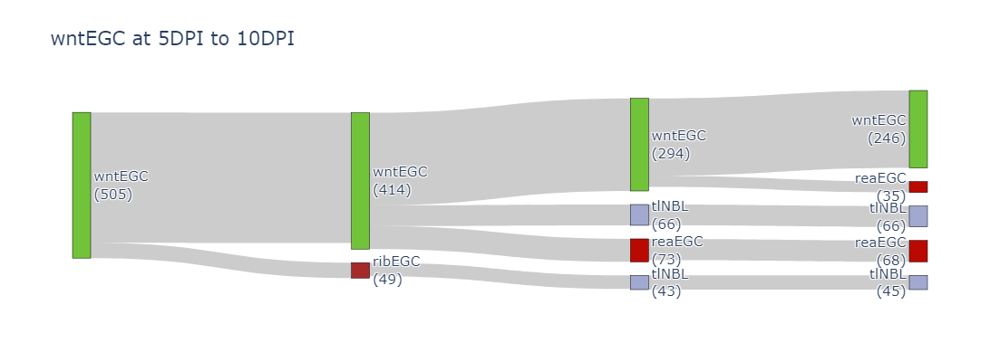

In [50]:
# wntEGC at 5DPI to 10DPI
init_cell_wnt_5DPI = data_train_wnt[train_time[1]]
init_cell_type = 'wntEGC'
init_time = 5 - common_initial_time_point
end_time = 10 - common_initial_time_point
_, _, all_cell_type, all_cell_id, all_time_point = evolution_forward(init_cell_wnt_5DPI, model, model_anno, init_time, end_time, init_cell_type, 
                                                                     delta_t = 0.1)


time_points = [5, 6.7, 8.4, 10]
# time_points = [5, 7.5, 10]
time_points = [cur_time - common_initial_time_point for cur_time in time_points]
transition_tree_wnt_5DPI = build_transition_tree(all_cell_id, all_cell_type, all_time_point, time_points)
plot_sankey_from_tree(transition_tree_wnt_5DPI, cell_type_color_map, threshold=25, title='wntEGC at 5DPI to 10DPI', 
                      font_size=15.3, width = 725, height=400, scale=5, save_path=None)

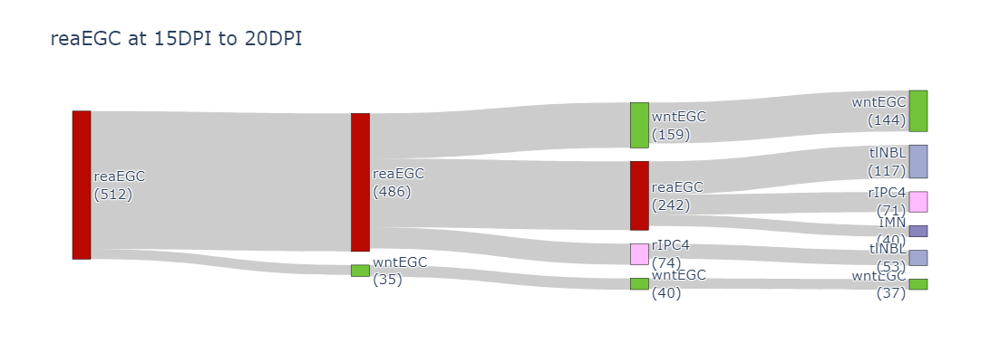

In [51]:
# reaEGC at 15DPI to 20DPI
init_cell_rea_15DPI = data_train_rea[train_time[3]]
init_cell_type = 'reaEGC'
init_time = 15 - common_initial_time_point
end_time = 20 - common_initial_time_point
_, _, all_cell_type, all_cell_id, all_time_point = evolution_forward(init_cell_rea_15DPI, model, model_anno, init_time, end_time, init_cell_type, 
                                                                     delta_t = 0.1)


time_points = [15, 16.7, 18.4, 20]
time_points = [cur_time - common_initial_time_point for cur_time in time_points]
transition_tree_rea_15DPI = build_transition_tree(all_cell_id, all_cell_type, all_time_point, time_points)
plot_sankey_from_tree(transition_tree_rea_15DPI, cell_type_color_map, threshold=26, title='reaEGC at 15DPI to 20DPI', 
                      font_size=15.3, width = 725, height=400, scale=5, save_path=None)

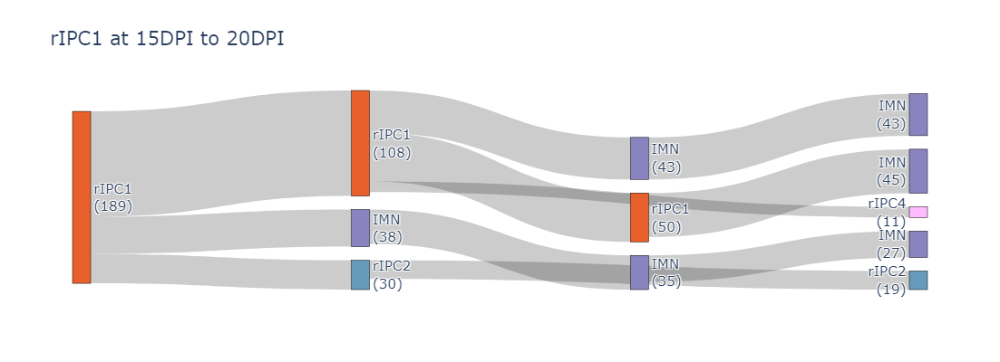

In [52]:
# rIPC1 at 15DPI to 20DPI
init_cell_rIPC1_15DPI = data_train_rIPC1[train_time[0]]
init_cell_type = 'rIPC1'
init_time = 15 - common_initial_time_point
end_time = 20 - common_initial_time_point
_, _, all_cell_type, all_cell_id, all_time_point = evolution_forward(init_cell_rIPC1_15DPI, model, model_anno, init_time, end_time, init_cell_type, 
                                                                     delta_t = 0.1)


time_points = [15, 16.7, 18.4, 20]
time_points = [cur_time - common_initial_time_point for cur_time in time_points]
transition_tree_rIPC1_15DPI = build_transition_tree(all_cell_id, all_cell_type, all_time_point, time_points)
plot_sankey_from_tree(transition_tree_rIPC1_15DPI, cell_type_color_map, threshold=9, title='rIPC1 at 15DPI to 20DPI', 
                      font_size=15.3, width = 725, height=400, scale=5, save_path=None)

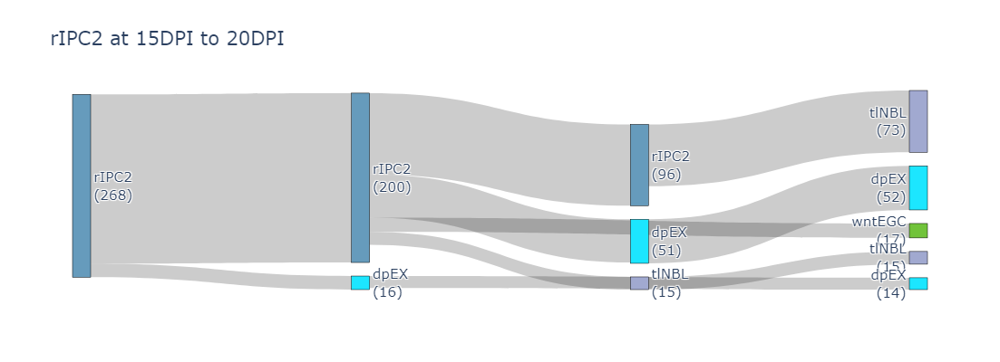

In [53]:
# rIPC2 at 15DPI to 20DPI
init_cell_rIPC2_15DPI = data_train_rIPC2[train_time[0]]
init_cell_type = 'rIPC2'
init_time = 15 - common_initial_time_point
end_time = 20 - common_initial_time_point
_, _, all_cell_type, all_cell_id, all_time_point = evolution_forward(init_cell_rIPC2_15DPI, model, model_anno, init_time, end_time, init_cell_type, 
                                                                     delta_t = 0.1)


time_points = [15, 16.7, 18.4, 20]
time_points = [cur_time - common_initial_time_point for cur_time in time_points]
transition_tree_rIPC2_15DPI = build_transition_tree(all_cell_id, all_cell_type, all_time_point, time_points)
plot_sankey_from_tree(transition_tree_rIPC2_15DPI, cell_type_color_map, threshold=13, title='rIPC2 at 15DPI to 20DPI', 
                      font_size=15.3,width = 725, height=400, scale=5, save_path=None)

## Plot cell number

In [54]:
def plot_all_type_number_time(data, all_time, cell_type, cell_type_color_map, figsize = (6, 5.5), marker_idx=None, save_path=None):
    import matplotlib.pyplot as plt
    from collections import Counter
    
    # 计算每团点云的类型的个数
    type_counts_per_cloud = [Counter(cloud) for cloud in data]
    
    # 提取所有可能的类型
    # all_types = set(cur_type for cloud in data for cur_type in cloud)
    all_types = cell_type
    
    # 创建一个字典来存储每种类型在每个时间点的计数
    type_counts_over_time = {cur_type: [] for cur_type in all_types}
    
    # 填充字典
    for counts in type_counts_per_cloud:
        for cur_type in all_types:
            type_counts_over_time[cur_type].append(counts[cur_type])
    
    # 绘制折线图
    plt.figure(figsize=figsize)
    for cur_type, counts in type_counts_over_time.items():
        if marker_idx:
            plt.plot(np.array(all_time) + 2.0, counts, '-o', label=cur_type, color = cell_type_color_map[cur_type], markevery=marker_idx)
        else:
            plt.plot(np.array(all_time) + 2.0, counts, label=cur_type, color = cell_type_color_map[cur_type])
    
    plt.xlabel('time')
    # plt.ylabel('cell number')
    plt.title('cell number')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()

In [57]:
init_cell_all = data_train[train_time[0]]
init_time = 2 - common_initial_time_point
end_time = 20 - common_initial_time_point
_, all_spa, all_cell_type, _, all_time_point = evolution_forward(init_cell_all, model, model_anno, init_time, end_time, 
                                                                     delta_t = 0.1)

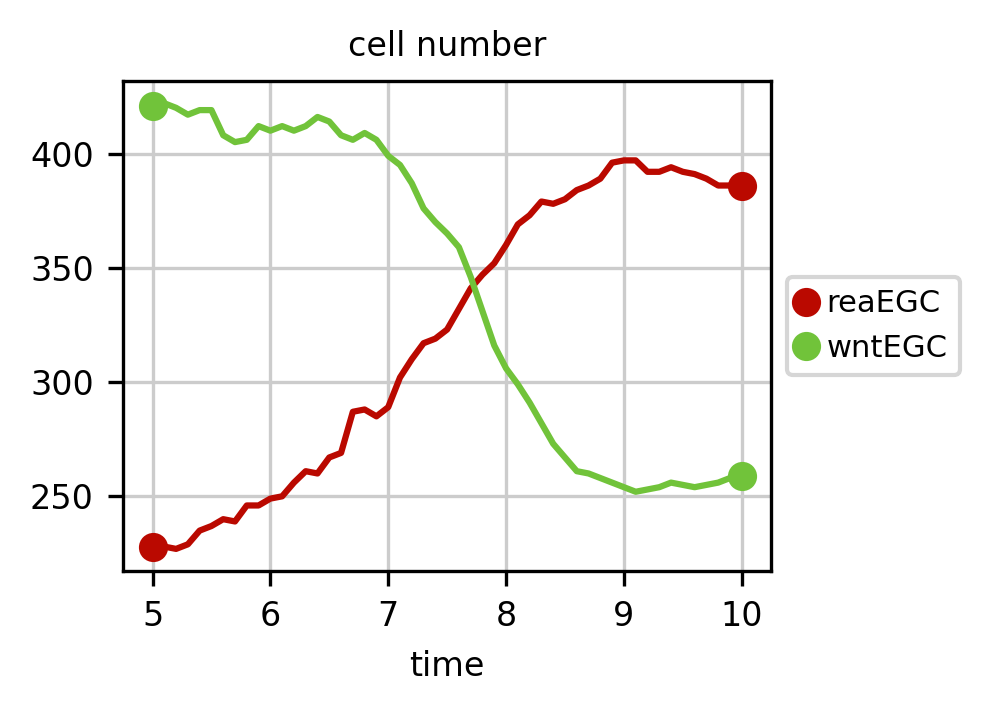

In [58]:
marker_idx = [0, 50]
plot_all_type_number_time(all_cell_type[30:81], all_time_point[30:81], ['reaEGC', 'wntEGC'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

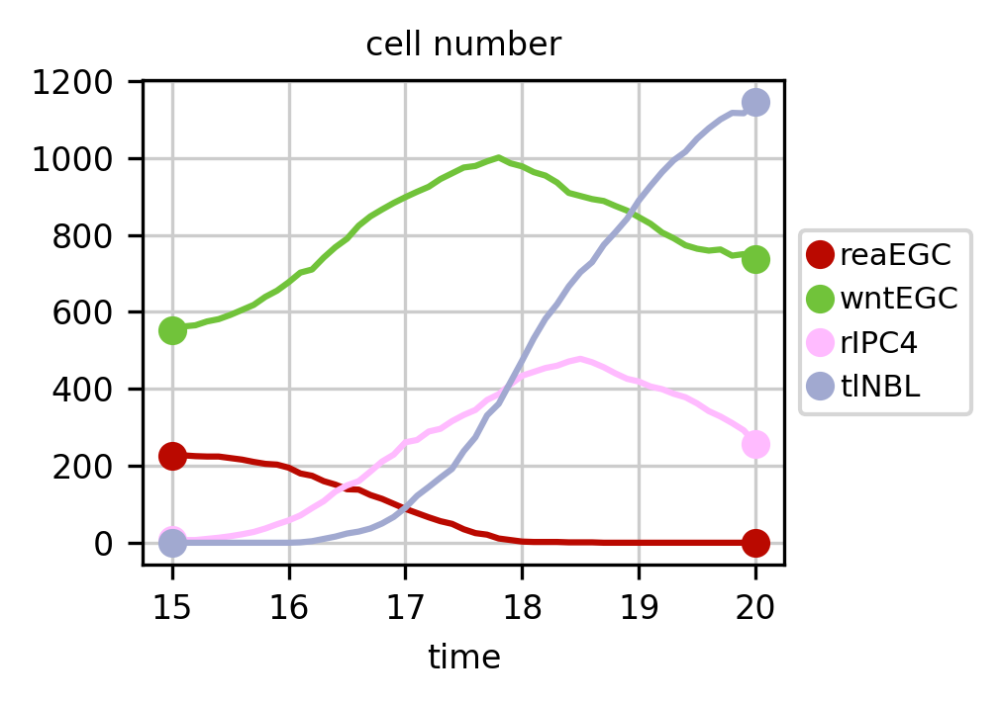

In [59]:
marker_idx = [0, 50]
plot_all_type_number_time(all_cell_type[130:181], all_time_point[130:181], ['reaEGC', 'wntEGC', 'rIPC4', 'tlNBL'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

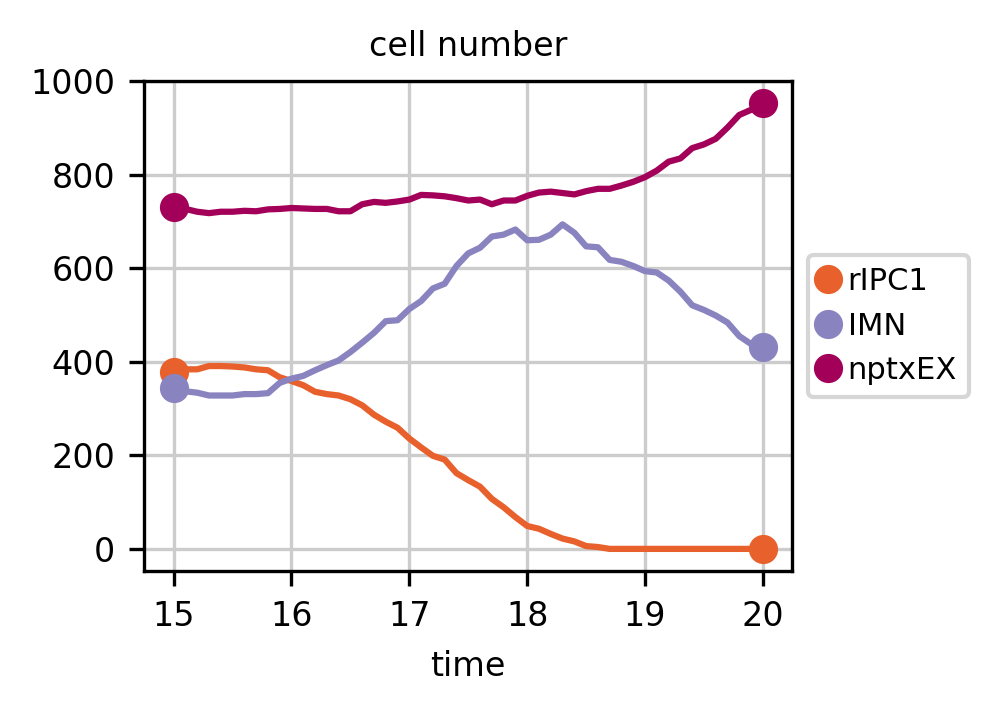

In [60]:
marker_idx = [0, 50]
plot_all_type_number_time(all_cell_type[130:181], all_time_point[130:181], ['rIPC1', 'IMN', 'nptxEX'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

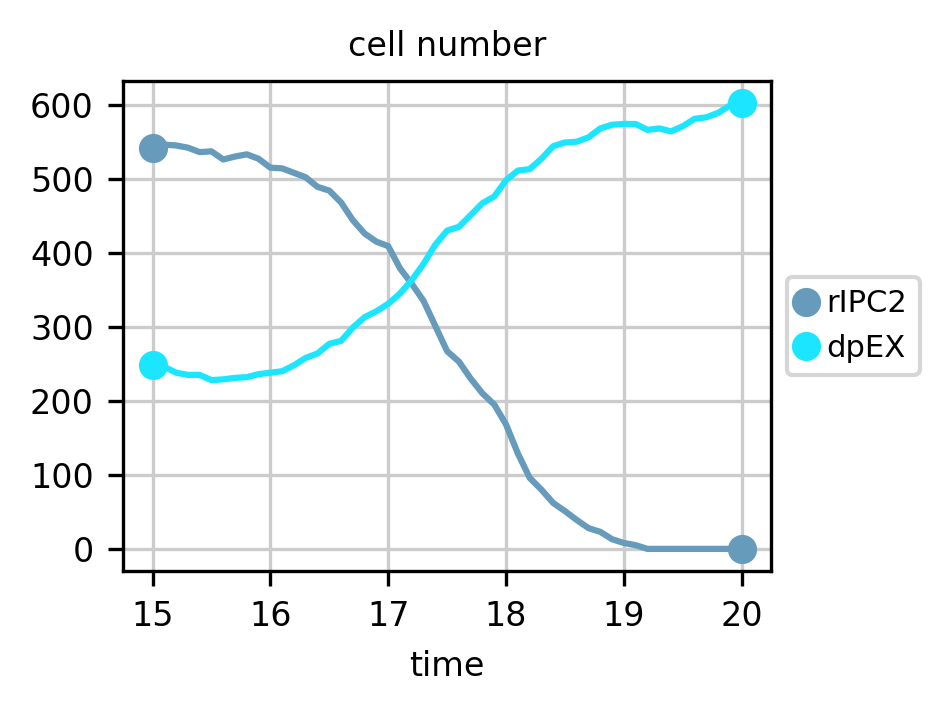

In [61]:
marker_idx = [0, 50]
plot_all_type_number_time(all_cell_type[130:181], all_time_point[130:181], ['rIPC2', 'dpEX'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

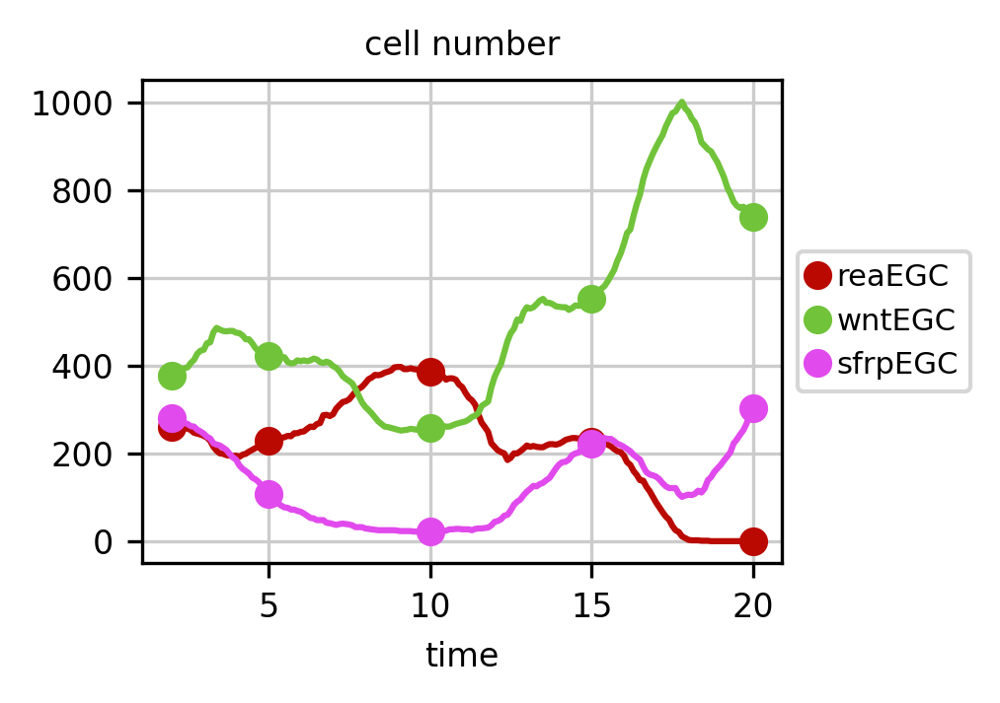

In [62]:
marker_idx = [0, 30, 80, 130, 180]
plot_all_type_number_time(all_cell_type, all_time_point, ['reaEGC', 'wntEGC','sfrpEGC'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

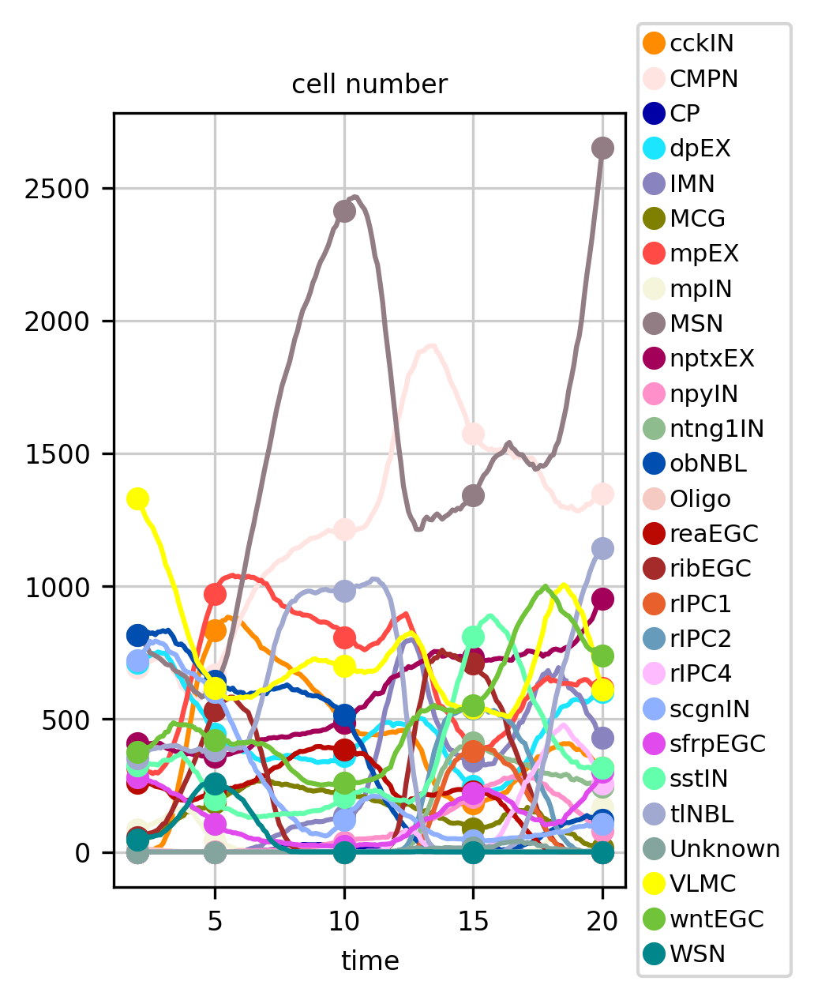

In [63]:
marker_idx = [0, 30, 80, 130, 180]
plot_all_type_number_time(all_cell_type, all_time_point, cell_type_Annotation, cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3), save_path=None)

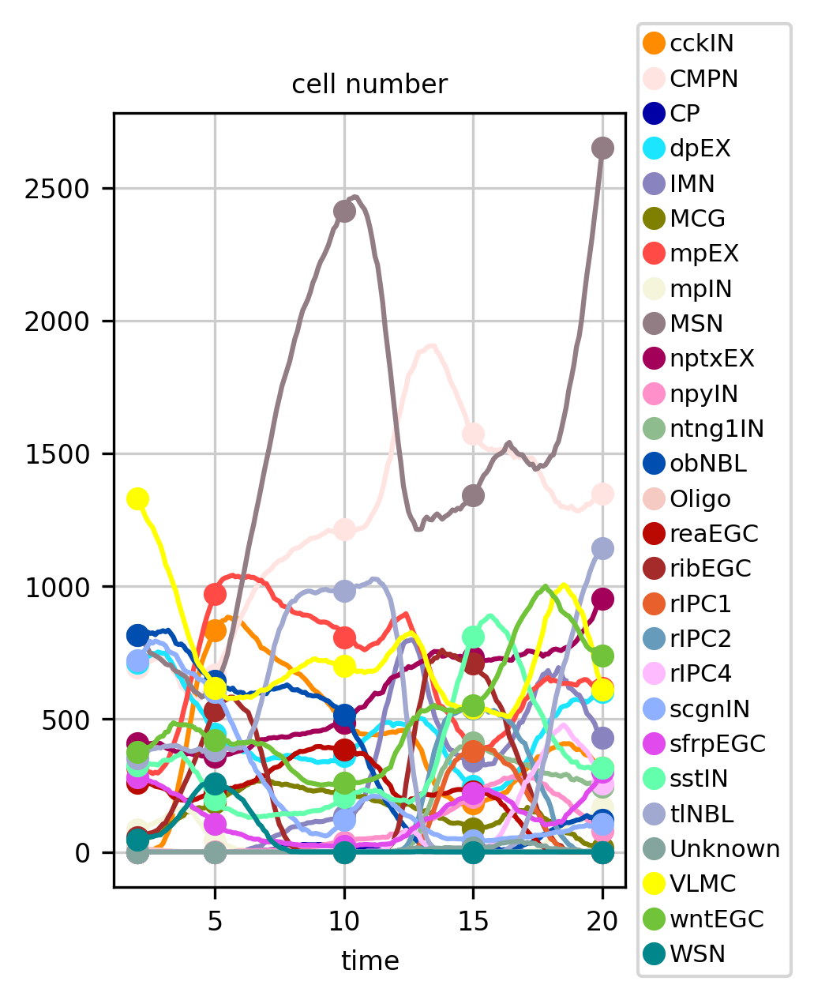

In [64]:
marker_idx = [0, 30, 80, 130, 180]
plot_all_type_number_time(all_cell_type, all_time_point, cell_type_Annotation, cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3), save_path=None)

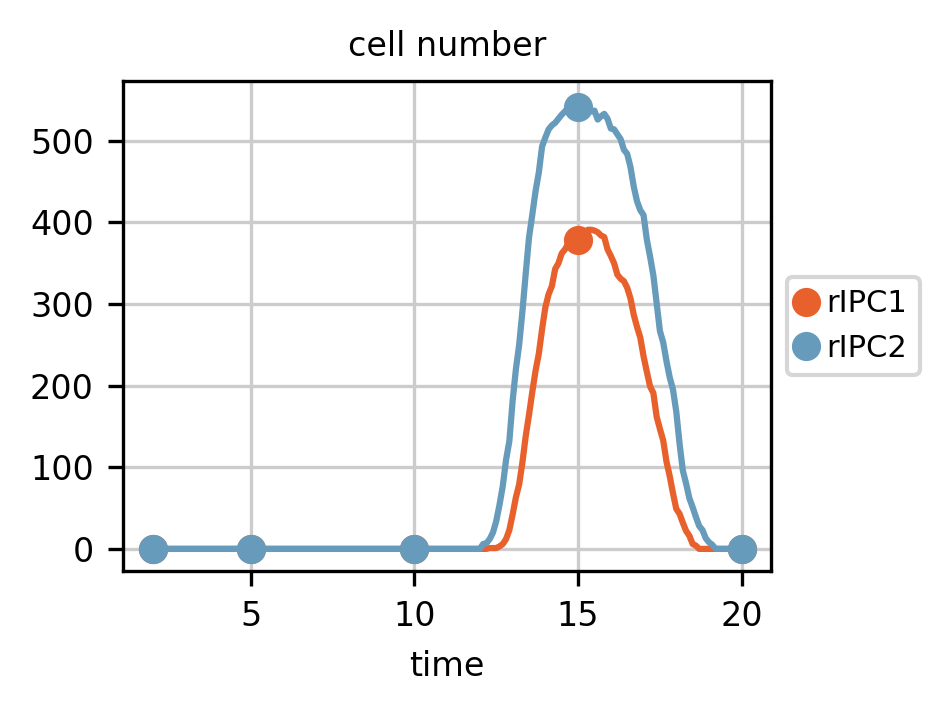

In [66]:
marker_idx = [0, 30, 80, 130, 180]
plot_all_type_number_time(all_cell_type, all_time_point, ['rIPC1', 'rIPC2'], cell_type_color_map, marker_idx=marker_idx, 
                          figsize = (2.77, 4.3/2), save_path=None)

## Plot all dynamics

In [67]:
def plot_gene_and_move_scanpy(cell_type_time_series_list, z_time_series_list, time_points, gif_name):

    fig = plt.figure(figsize=(6,4))
    ax = fig.add_subplot(111)

    num_frames = len(time_points)

    def update(frame):
        ax.clear()
        adata_cur = ad.AnnData(np.zeros((len(cell_type_time_series_list[frame]),1)))
        adata_cur.obsm['X_spatial_after_stVCR'] = z_time_series_list[frame]
        categories = adata.obs['Annotation'].cat.categories
        adata_cur.obs['Annotation'] = pd.Series(pd.Categorical(cell_type_time_series_list[frame], categories=categories), 
                                                index=adata_cur.obs.index)
        adata_cur.uns['Annotation_colors'] = adata.uns['Annotation_colors']
        

        # scatter = sc.pl.scatter(adata_cur, basis='spatial', color='Annotation',
        #               size = 10, legend_loc= 'right margin', show=True, ax=ax)
        scatter = sc.pl.scatter(adata_cur, basis='spatial_after_stVCR', color='Annotation',
              size = 10, legend_loc= 'none', show=True, ax=ax)
        ax.set_title(f'{time_points[frame] + 2} DPI')
        legend = ax.legend(bbox_to_anchor=(1.0, 0.05), fontsize=8, ncol=7, frameon=False,)
        for handle in legend.legendHandles:
            handle.set_sizes([75])

        return scatter

    animation = FuncAnimation(fig, update, frames=num_frames, interval=50, blit=False)
    if gif_name:
        animation.save(gif_name, fps=2, dpi=150)
    plt.show()

MovieWriter ffmpeg unavailable; using Pillow instead.


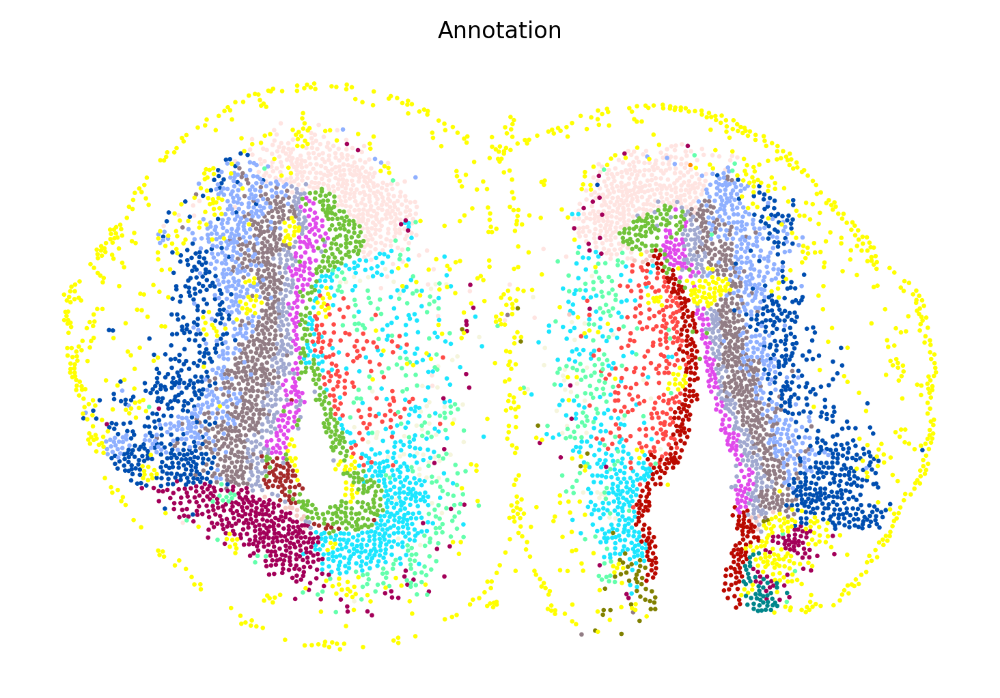

In [ ]:
plot_gene_and_move_scanpy(all_cell_type, all_spa, all_time_point, gif_name='./ARTISTA.gif')